In [594]:
from F00_global_variables import *

sys.path.append('/mnt/thymus_atlas')
import scjp
from scjp import markers, model, draw, utils, network, vdj

sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=100, color_map='OrRd')
sc.logging.print_version_and_date()
%load_ext autoreload
%autoreload 2
%load_ext rpy2.ipython

version = 'HTA08.v01.A06.'
fig_folder = '02_Output'

os.chdir('/mnt/08_thymus_cell_atlas/')

print('Version: '+version)

Running Scanpy 1.4.3 on 2019-10-07 15:25.
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython
Version: HTA08.v01.A06.


## Write

In [659]:
tdata

AnnData object with n_obs × n_vars = 76994 × 4403 
    obs: 'Sample', 'n_counts', 'n_genes', 'donor', 'organ', 'sort', 'method', 'file', 'mito', 'doublet_scores', 'predicted_doublets', 'name', 'source', 'birth', 'batch', 'bbk', 'Order', 'File', 'Age', 'Enzyme', 'Source', 'Stage', 'Stage2', 'scrublet_doublets', 'is_Fig1', 'is_file_Fig1', 'true_doublets', 'missed_doublets_scbl', 'missed_doublets_jp', 'anno_doublet_4_scores', 'anno_doublet_5_scores', 'anno_doublet_6_scores', 'anno_doublet_7_scores', 'anno_doublet_8_scores', 'anno_doublet_T_scores', 'dbl_jp_method', 'broad_doublets', 'anno_pred', 'anno_fig1_detailed.replaced.1', 'anno_predict_B.replaced.1', 'Cycle_score', 'isCycle', 'anno_predict_fig1.replaced.1', 'anno_fig1_detailed.replaced.2', 'anno_fig1_detailed', 'anno_predict_B.replaced.2', 'anno_predict_B', 'anno_predict_fig1.replaced.2', 'anno_predict_fig1', 'anno_final_v1', 'anno_final_v2_epi', 'Anno_level_1', 'Anno_level_2', 'Anno_level_3', 'Anno_level_4', 'Anno_level_5', 'Anno_l

In [663]:
tout = sc.AnnData(tdata.raw.X)
tout.obs_names = tdata.obs_names
tout.var_names = tdata.raw.var_names

for k in ['Sample','donor','organ','sort','method','file','is_TRA_p','is_TRB_p','is_TRA_np','is_TRB_np','Age','Source']:
    tout.obs[k] = tdata.obs[k]

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [664]:
tout.obs['cell types'] = tdata.obs['anno_final_v2_epi']
tout.obsm['X_umap'] = tdata.obsm['X_umap_2d']
tout.obsm['X_umap_3d'] = tdata.obsm['X_umap_3d']

In [665]:
scjp.write(tout,version,'Science_human_tcells')

Only considering the two last: ['.A06', '.Science_human_tcells'].
HTA08_v01_A06_Science_human_tcells = 'HTA08.v01.A06.Science_human_tcells'


## Save

## Load

In [208]:
hdata = sc.read('HTA07.A04.v02.HSC_pellin')

Only considering the two last: ['.v02', '.HSC_pellin'].


## Fig2

In [297]:
scjp.write(tdata,version,'fig2_tdata_fdg_added')

Only considering the two last: ['.v02', '.fig2_tdata_fdg_added'].
HTA07_A05_v02_fig2_tdata_fdg_added = 'HTA07.A05.v02.fig2_tdata_fdg_added'


In [55]:
tdata = sc.read('HTA07.A05.v02.fig2_tdata')

Only considering the two last: ['.v02', '.fig2_tdata'].


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [72]:
fig1 = sc.read('HTA08.v01.A05.fig1_data_vdj_added')

Only considering the two last: ['.A05', '.fig1_data_vdj_added'].


In [81]:
Tfsl = sc.read('/mnt/02_FCA_ImmunoP/02_FCA_union_cells/write/A41.v04.matureT_fetal_THLI.h5ad')

Only considering the two last: ['.matureT_fetal_THLI', '.h5ad'].
Only considering the two last: ['.matureT_fetal_THLI', '.h5ad'].


In [58]:
tdata.obsm['X_umap'] = tdata.obsm['X_umap_2d']

In [69]:
## Add VDJ

vdj_df = pkl.load(open('HTA07.A06.v02.vdj_df.pkl','rb'))
scjp.vdj.update_vdj(tdata,vdj_df)

02_Output/HTA08.v01.A06.Fig_T_umap.pdf


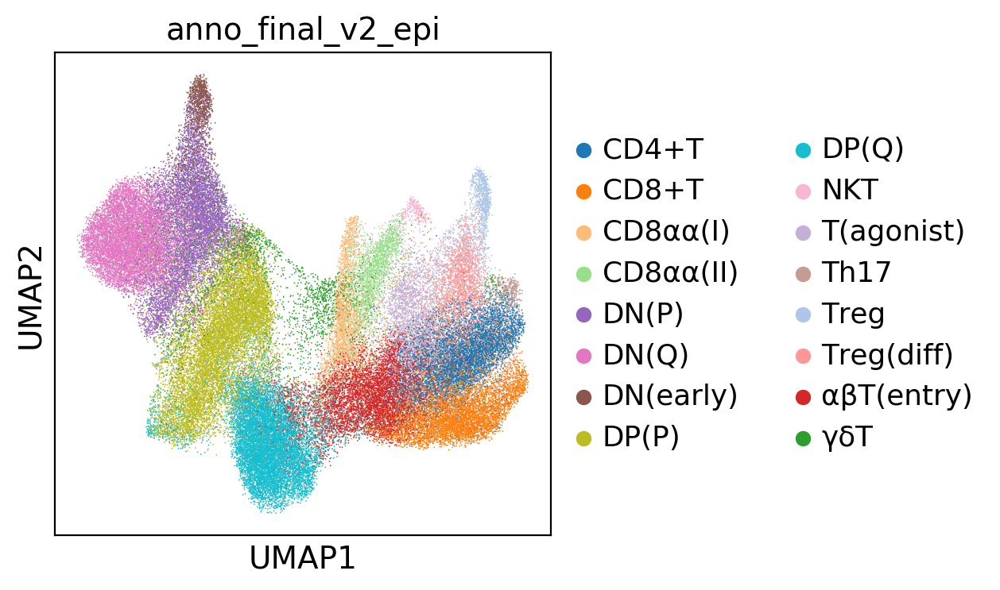

In [595]:
scjp.us(tdata,'anno_final_v2_epi')
scjp.jp_save_fig(version,'Fig_T_umap',fig_folder=fig_folder)

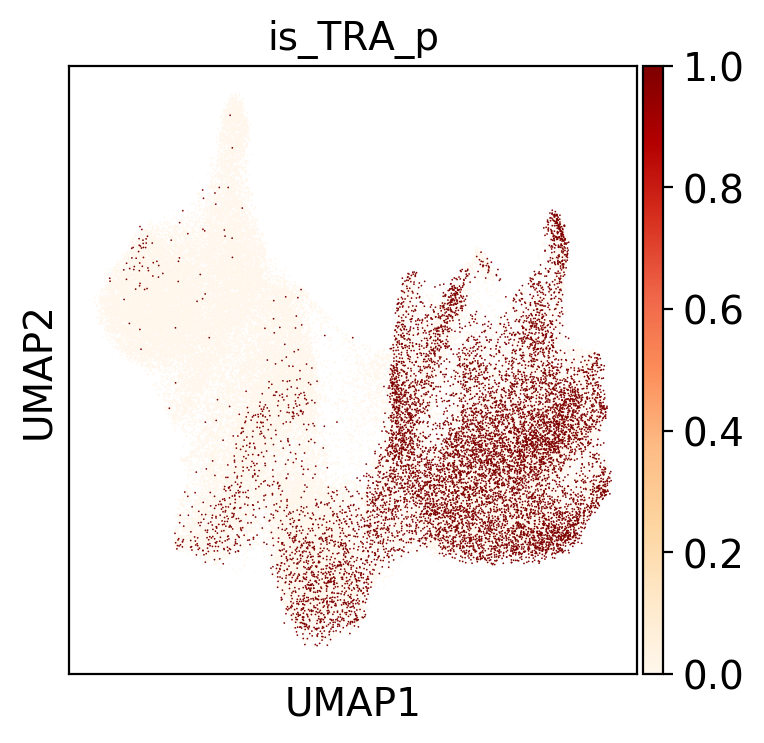

In [645]:
scjp.us(tdata,'is_TRA_p')

## Run graph

In [293]:
sc.tl.draw_graph(tdata)

drawing single-cell graph using layout "fa"
    finished (0:15:56.20) --> added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm)


02_Output/HTA07.A05.v02.FigS6_fdg.pdf


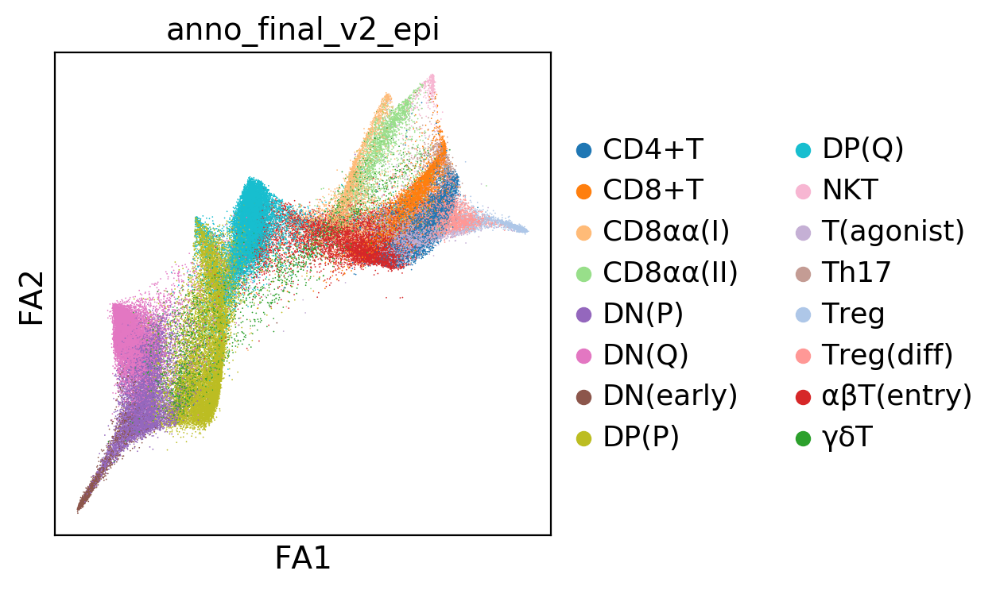

In [330]:
sc.pl.draw_graph(tdata,color='anno_final_v2_epi',show=False)
scjp.jp_save_fig(version,'FigS6_fdg',fig_folder=fig_folder)

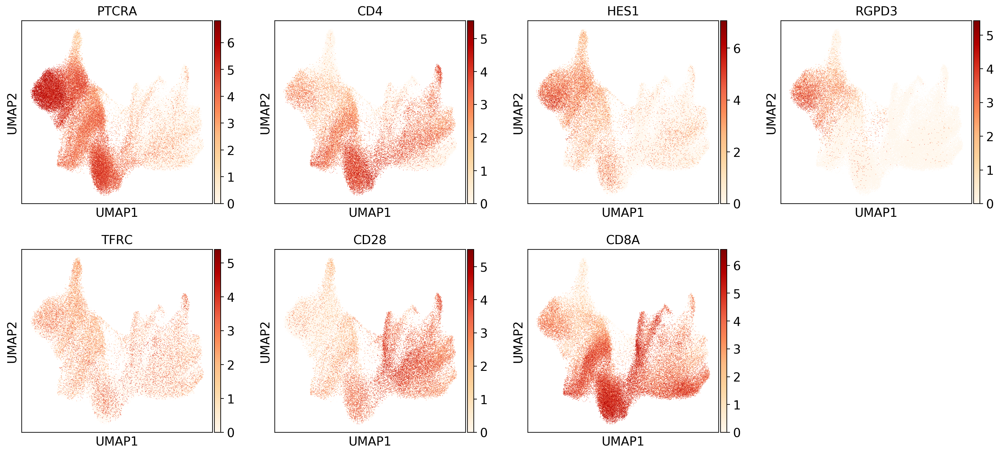

In [458]:
scjp.us(tdata,'PTCRA,CD4,HES1,RGPD3,TFRC,CD28,CD8A')

## Draw Fig2 figures

In [8]:
c = ['#1f77b4',
 '#ff7f0e',
 '#2ca02c',
 '#d62728',
 '#9467bd',
 '#8c564b',
 '#e377c2',
 '#bcbd22',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2']

In [9]:
fig3_order = [
 'CD4+T',
 'CD8+T',
  'γδT',
 'αβT(entry)',
 'DN(P)',
 'DN(early)',
 'DN(Q)',
 'DP(P)',
 'DP(Q)',
 'Treg',
 'CD8αα(I)',
 'CD8αα(II)',
 'Treg(diff)',
 'T(agonist)',
  'Th17', 'NKT']

In [16]:
fig3_anno_key = 'anno_final_v2_epi'

In [10]:
fig3_cdict = {x:y for x,y in zip(fig3_order,c)}

In [17]:
tdata.uns[fig3_anno_key+'_colors'] = [fig3_cdict[x] for x in sorted(set(tdata.obs[fig3_anno_key]))]

## Tagonist

In [604]:
Tregs = tdata[tdata.obs[fig3_anno_key].isin('T(agonist),Treg,Treg(diff)'.split(','))].copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [613]:
sc.pp.pca(Tregs)

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:00.81)


In [614]:
scjp.bbknn_umap(Tregs,'method',15)

computing batch balanced neighbors
	finished (0:00:00.22) --> added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:00:12.31) --> added
    'X_umap', UMAP coordinates (adata.obsm)


02_Output/HTA08.v01.A06.FIG3_T_UMAP.pdf


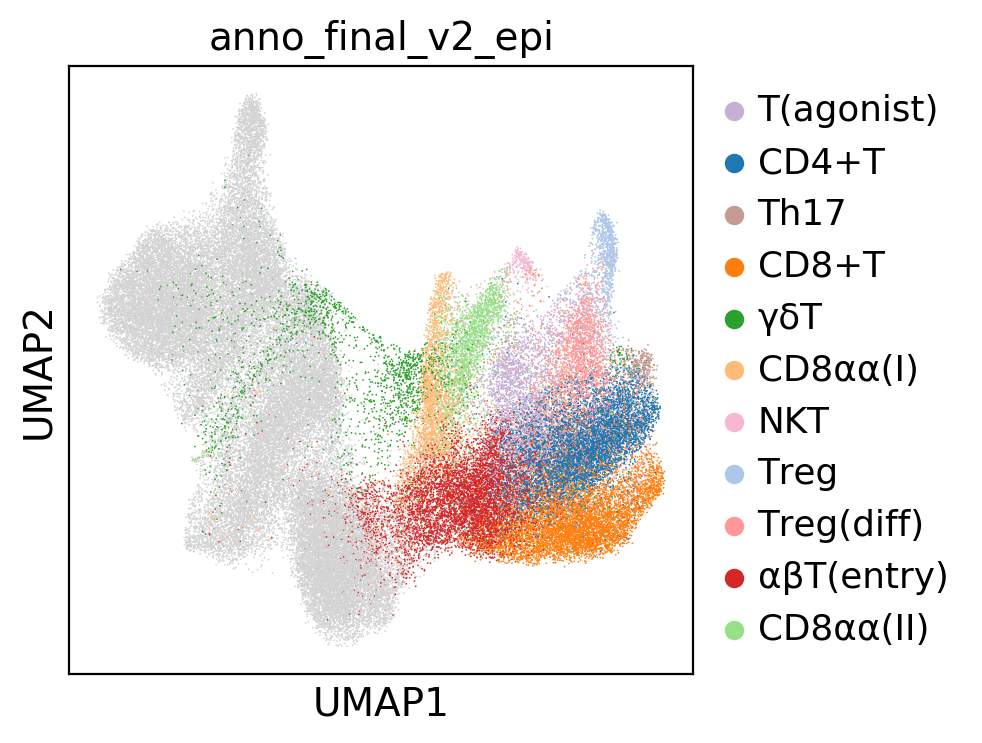

In [596]:
sc.pl.umap(tdata,color=fig3_anno_key,groups=['T(agonist)',
 'CD4+T',
 'Th17',
 'CD8+T',
 'γδT',
 'CD8αα(I)',
 'NKT',
 'Treg',
 'Treg(diff)',
 'αβT(entry)',
 'CD8αα(II)'],show=False)
scjp.jp_save_fig(version,'FIG3_T_UMAP',fig_folder=fig_folder)

02_Output/HTA08.v01.A06.FIG2_T_UMAP.pdf


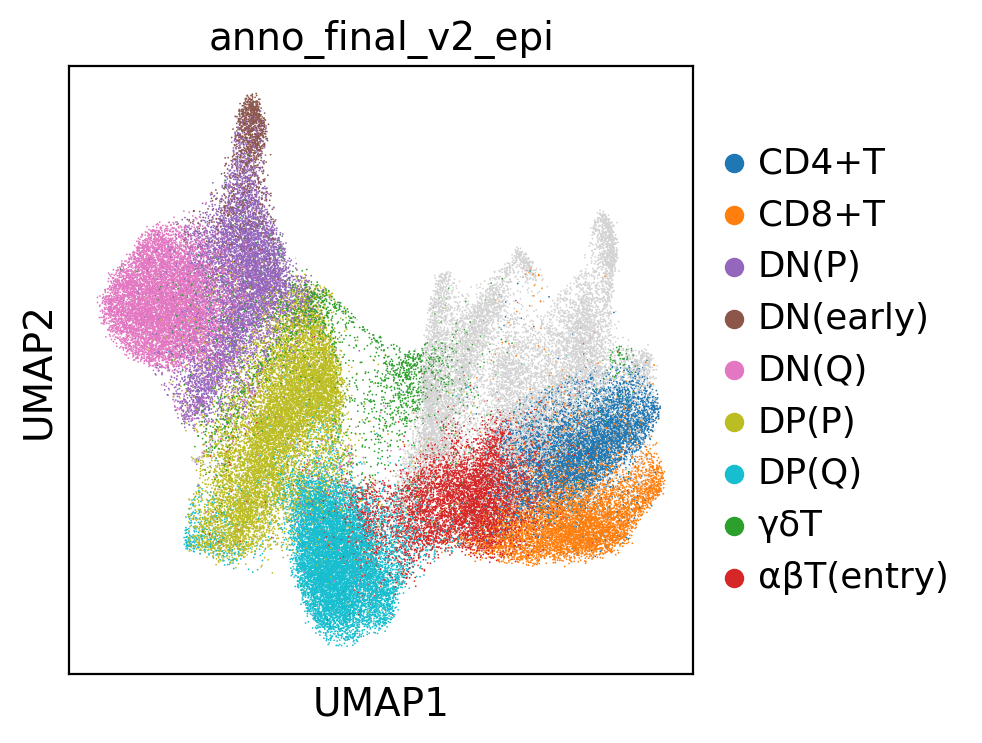

In [597]:
sc.pl.umap(tdata,color=fig3_anno_key,groups=[ 'CD4+T',
 'CD8+T',
 'DN(P)',
 'DN(early)',
 'DN(Q)',
 'DP(P)',
 'DP(Q)',
  'γδT',
 'αβT(entry)'],show=False)
scjp.jp_save_fig(version,'FIG2_T_UMAP',fig_folder=fig_folder)

02_Output/HTA08.v01.A06.Fig_PTCRA.pdf


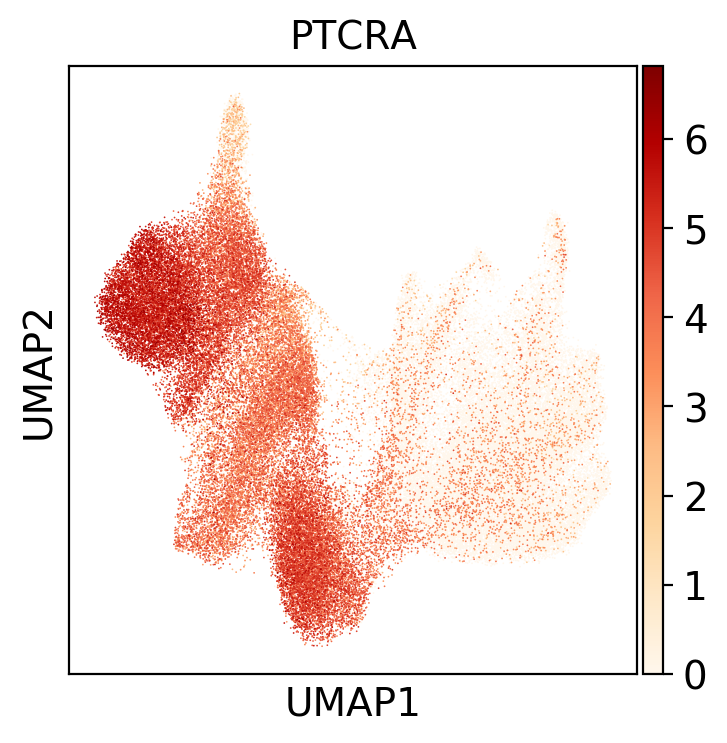

In [598]:
scjp.us(tdata,'PTCRA')
scjp.jp_save_fig(version,'Fig_PTCRA',fig_folder=fig_folder)

In [32]:
np.random.seed(0)
b = np.random.choice([True,False],size=len(tdata))

02_Output/HTA07.A05.v02.Fig2E_CDK.pdf


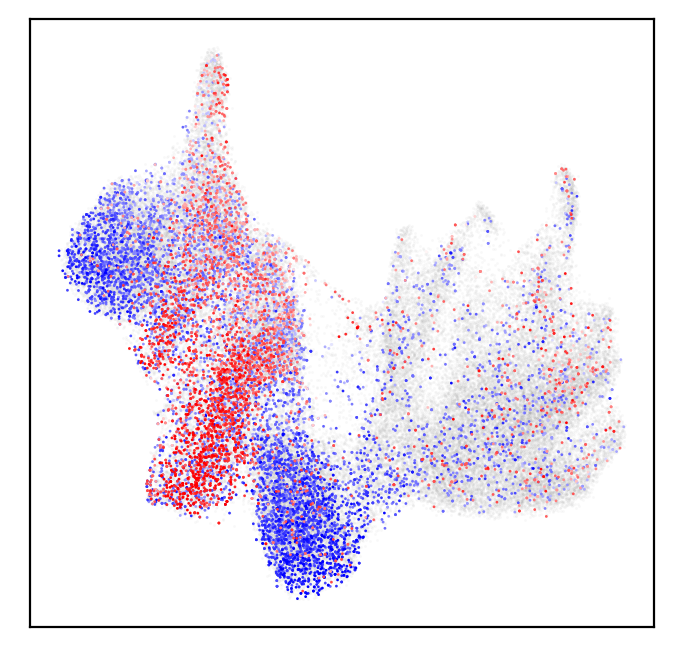

In [59]:
import matplotlib

adata = tdata
gene_list = [
              ['RAG1','blue'],['CDK1','red'],
             ]

color_options = 'blue,red,green,orange,magenta'.split(',')

U = adata.obsm['X_umap']
ux = U[:,0]
uy = U[:,1]

plt.scatter(ux,uy,color='grey',alpha=0.05,s=1,zorder=-2,rasterized=True,linewidth=0)

for i, g in enumerate(gene_list):

    colors = adata.raw.X[:,adata.raw.var_names==g[0]].todense().A1

    low = np.percentile(colors[colors>0],0)
    
    if i ==0:
        c = (colors > low) &b
    if i ==1:
        c = (colors > low) &b
        
    vmax = np.max(colors)
    vmin = np.mean(colors)
    
    x = ux[c]
    y = uy[c]
    c1 = colors[c]
    
    idx = np.argsort(c1)
    idx = np.random.choice(idx,int(len(idx)/2))
    
    x = x[idx]
    y = y[idx]
    c1 = c1[idx]
    
    idx = np.argsort(c1)
    
    x = x[idx]
    y = y[idx]
    c1 = c1[idx]
    
    cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ["white",color_options[i]])

    plt.scatter(x,y,c = c1, cmap=cmap, vmax = vmax*0.8,
                s=1,alpha=1.0,zorder=i,linewidth=0.0,rasterized=True)

plt.xticks([])
plt.yticks([])
plt.grid(False)
scjp.jp_save_fig(version,'Fig2E_CDK',fig_folder=fig_folder)

['CD8A', 'blue']
['CD8B', 'green']
['CD4', 'red']
02_Output/HTA07.A05.v02.Fig2D_CD4CD8.pdf


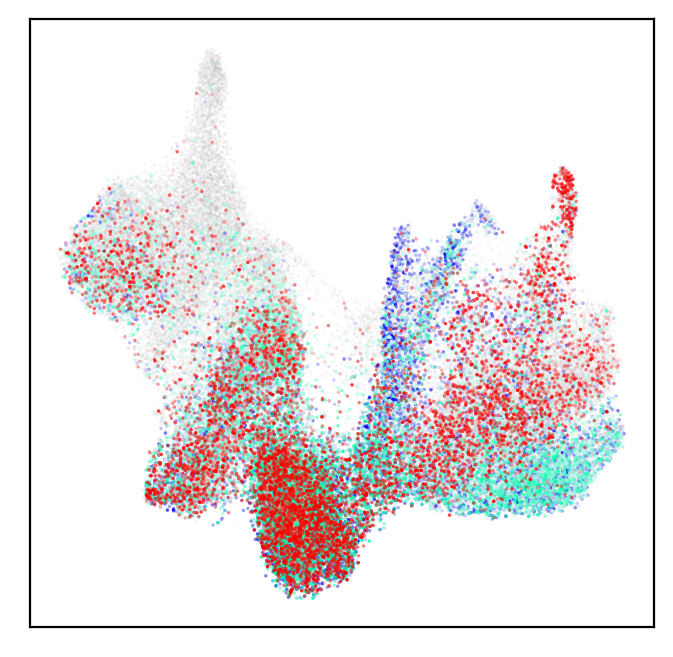

In [60]:
gene_list = [
              ['CD8A','blue'],['CD8B','green'],['CD4','red'],
             ]

color_options = '#0000ee,#00ffaa,#ff0000,orange,magenta'.split(',')

U = adata.obsm['X_umap']
ux = U[:,0]
uy = U[:,1]

plt.scatter(ux,uy,color='grey',alpha=0.05,s=1,zorder=-2,rasterized=True,linewidth=0)

for i, g in enumerate(gene_list):
    print(g)
    colors = adata.raw.X[:,adata.raw.var_names==g[0]].todense().A1
     
    low = np.percentile(colors[colors>0.1],20)
    c = (colors > low) 
        
    vmax = np.max(colors)
    vmin = np.mean(colors)
    
    x = ux[c]
    y = uy[c]
    c1 = colors[c]
    
    idx = np.argsort(c1)
    idx = np.random.choice(idx,int(len(idx)/2))
    
    x = x[idx]
    y = y[idx]
    c1 = c1[idx]
    
    idx = np.argsort(c1)
    
    x = x[idx]
    y = y[idx]
    c1 = c1[idx]
    
    cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ["white",color_options[i]])
    
    if i ==2:
        plt.scatter(x,y,c = c1, cmap=cmap, vmax = vmax*0.6,
                s=1.5,alpha=.5,zorder=i,linewidth=0.0,rasterized=True)
    else:
        plt.scatter(x,y,c = c1, cmap=cmap, vmax = vmax*.8,
                s=1.5,alpha=.5,zorder=i,linewidth=0.0,rasterized=True)
plt.xticks([])
plt.yticks([])
plt.grid(False)
scjp.jp_save_fig(version,'Fig2D_CD4CD8',fig_folder=fig_folder)

02_Output/HTA07.A05.v02.Fig2F_TCR.pdf


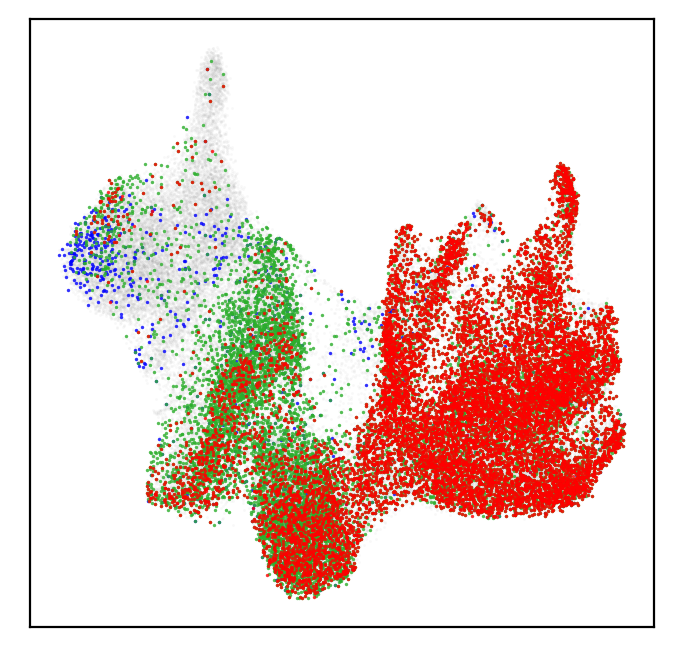

In [70]:
cond_list = [adata.obs['is_TRB_np'],adata.obs['is_TRB_p'],adata.obs['is_TRA_fl']]
color_list = ['blue','#2caf2c','#ff0000']

U = adata.obsm['X_umap']
ux = U[:,0]
uy = U[:,1]

plt.scatter(ux,uy,color='grey',alpha=0.05,s=1.0,zorder=-2,rasterized=True,linewidth=0)

for i,c1 in enumerate(cond_list):
    plt.scatter(ux[c1],uy[c1],color=color_list[i],alpha=0.8,s=1.5,zorder=i,linewidth=0.0,rasterized=True)

plt.xticks([])
plt.yticks([])
plt.grid(False)
scjp.jp_save_fig(version,'Fig2F_TCR',fig_folder=fig_folder)

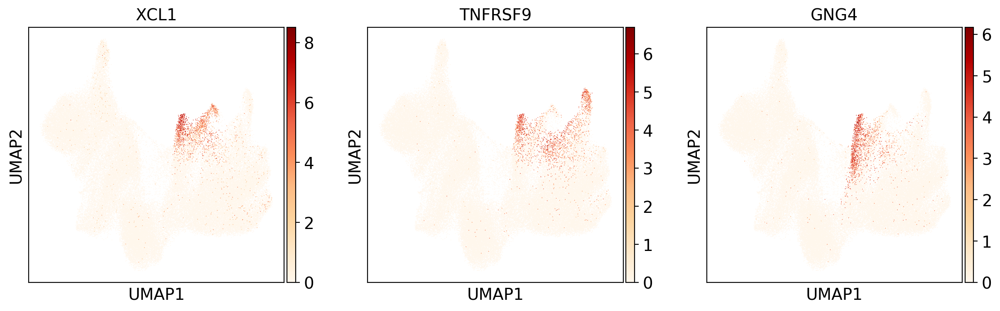

In [301]:
scjp.us(tdata,'XCL1,TNFRSF9,GNG4')

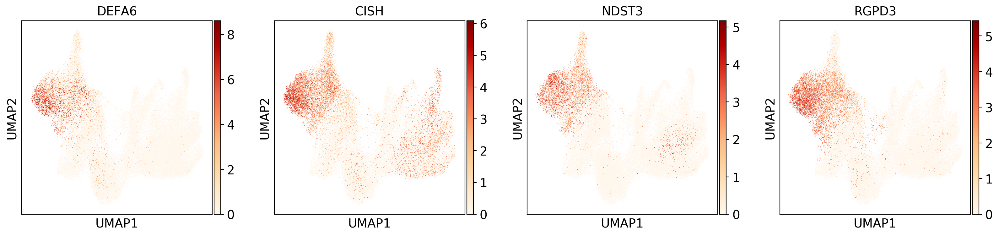

In [466]:
scjp.us(tdata,'DEFA6, CISH, NDST3, RGPD3'.split(', '))

In [327]:
def draw_feature_tdata(tdata,gene_list,obsm_key,file_name):
    import matplotlib

    color_options = 'red,blue,green'.split(',')

    U = tdata.obsm[obsm_key]
    ux = U[:,0]
    uy = U[:,1]

    plt.scatter(ux,uy,color='grey',alpha=0.05,s=1,zorder=-2,rasterized=True,linewidth=0)

    for i, g in enumerate(gene_list):

        colors = tdata.raw.X[:,tdata.raw.var_names==g].todense().A1

        low = np.percentile(colors[colors>0],20)


        c = (colors > low) 

        vmax = np.max(colors)
        vmin = np.mean(colors)

        x = ux[c]
        y = uy[c]
        c1 = colors[c]

        idx = np.argsort(c1)
        idx = np.random.choice(idx,int(len(idx)/2))

        x = x[idx]
        y = y[idx]
        c1 = c1[idx]

        idx = np.argsort(c1)

        x = x[idx]
        y = y[idx]
        c1 = c1[idx]

        cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ["white",color_options[i]])

        plt.scatter(x,y,c = c1, cmap=cmap, vmax = vmax*1,
                    s=1,alpha=1.0,zorder=i,linewidth=0.0,rasterized=True)

    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    scjp.jp_save_fig(version,file_name,fig_folder=fig_folder)
    plt.show()

02_Output/HTA07.A05.v02.Fig_S06_PDCD1_umap.pdf


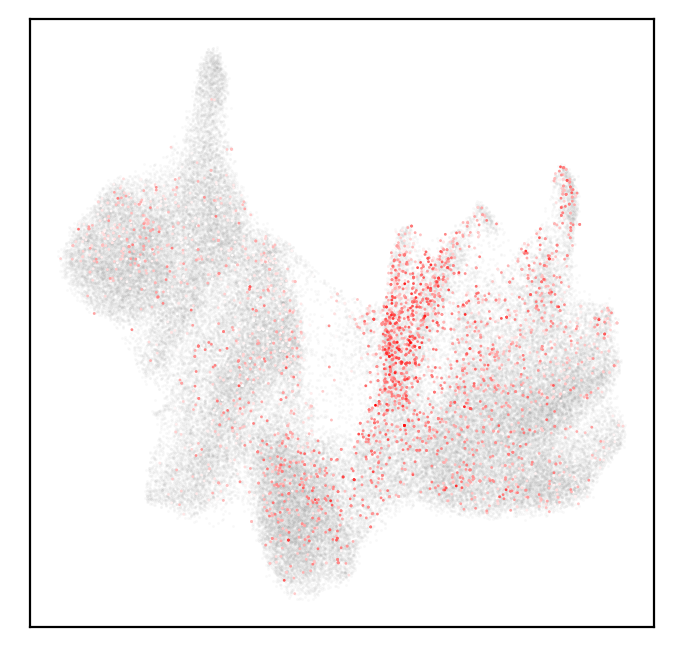

02_Output/HTA07.A05.v02.Fig_S06_GZE_umap.pdf


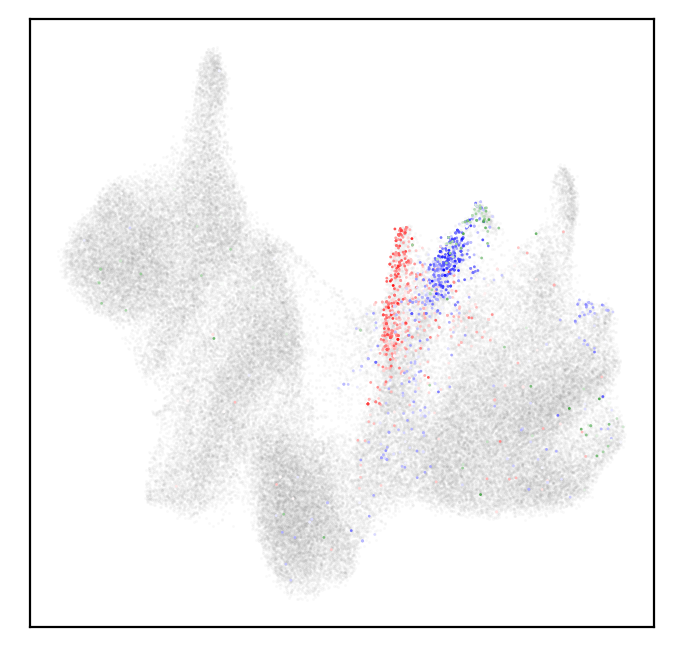

02_Output/HTA07.A05.v02.Fig_S06_TRADC_umap.pdf


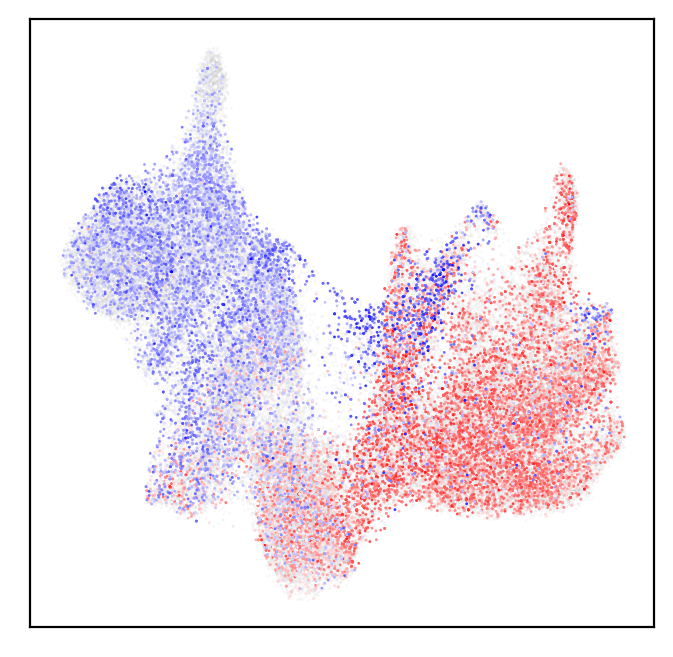

In [464]:
obsm_key = 'X_umap'
draw_feature_tdata(tdata,['PDCD1'],obsm_key,'Fig_S06_PDCD1_umap')
draw_feature_tdata(tdata,['GNG4','ZNF683','EOMES'],obsm_key,'Fig_S06_GZE_umap')
draw_feature_tdata(tdata,['TRAC','TRDC'],obsm_key,'Fig_S06_TRADC_umap')

02_Output/HTA07.A05.v02.Fig_S06_PDCD1_fdg.pdf


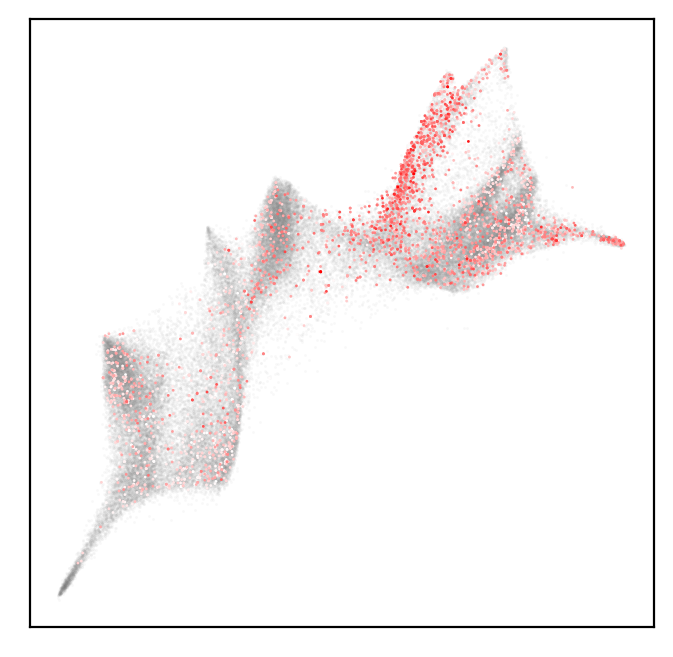

02_Output/HTA07.A05.v02.Fig_S06_GZE_fdg.pdf


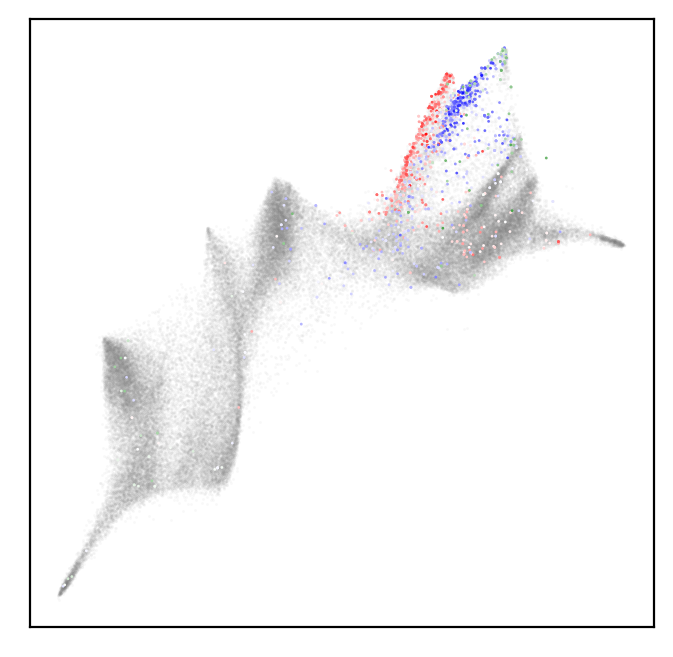

02_Output/HTA07.A05.v02.Fig_S06_TRADC_fdg.pdf


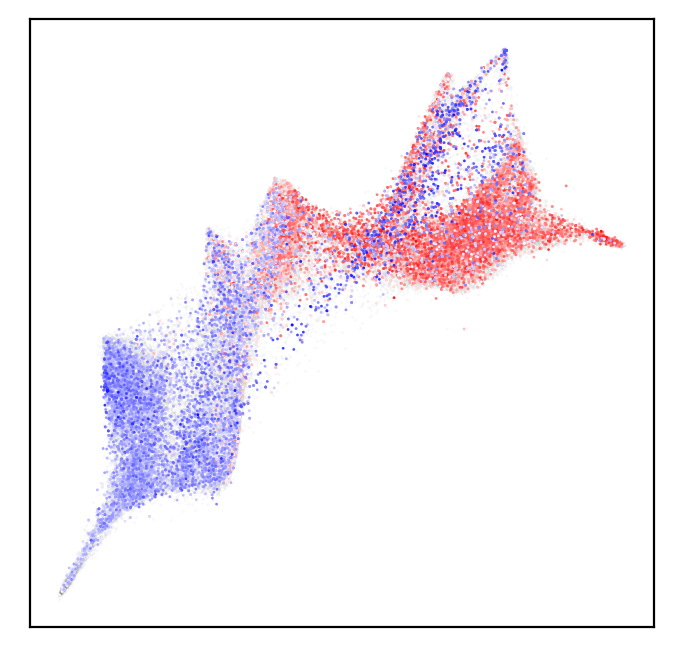

In [462]:
obsm_key = 'X_draw_graph_fa'
draw_feature_tdata(tdata,['PDCD1'],obsm_key,'Fig_S06_PDCD1_fdg')
draw_feature_tdata(tdata,['GNG4','ZNF683','EOMES'],obsm_key,'Fig_S06_GZE_fdg')
draw_feature_tdata(tdata,['TRAC','TRDC'],obsm_key,'Fig_S06_TRADC_fdg')

## Running pseudotime

In [263]:
sc.tl.diffmap(tdata)

computing Diffusion Maps using n_comps=15(=n_dcs)
    eigenvalues of transition matrix
    [1.         0.9934645  0.9821888  0.9793648  0.97250426 0.9648261
     0.9611259  0.9568907  0.9496959  0.944017   0.9340754  0.929714
     0.9277792  0.91410583 0.9113594 ]
    finished (0:00:09.96) --> added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns)


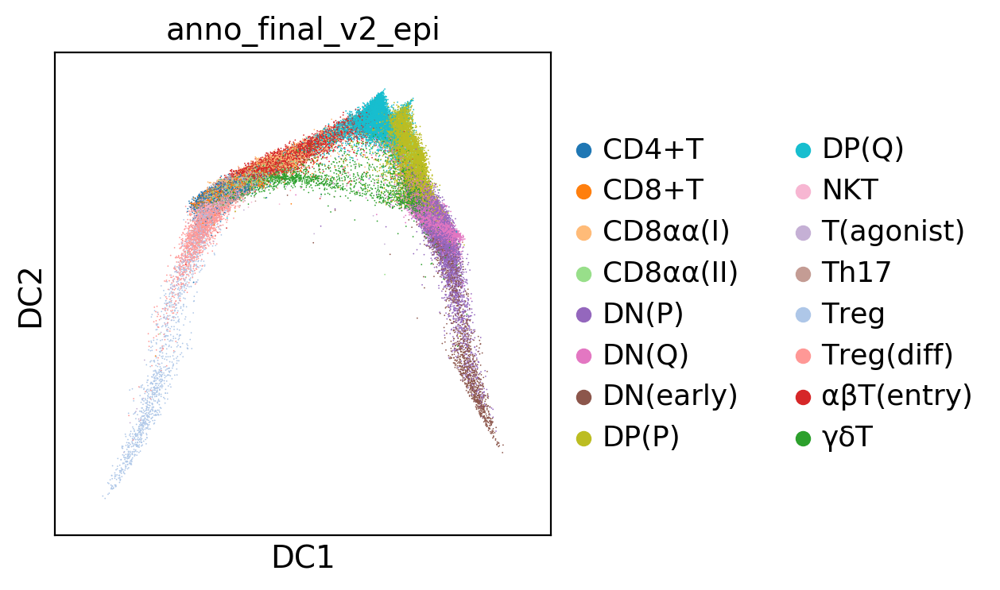

In [264]:
sc.pl.diffmap(tdata,color=fig3_anno_key)

In [274]:
tdata.uns['iroot'] = np.argmax(tdata.obsm['X_diffmap'][:,1])

In [275]:
sc.tl.dpt(tdata)

computing Diffusion Pseudotime using n_dcs=10
    finished (0:00:00.00) --> added
    'dpt_pseudotime', the pseudotime (adata.obs)


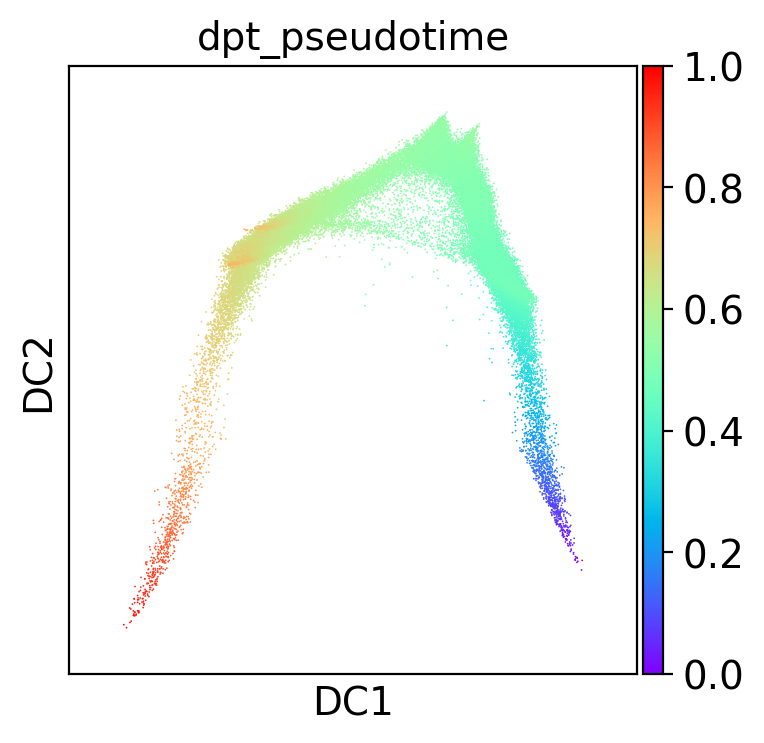

In [276]:
sc.pl.diffmap(tdata,color='dpt_pseudotime',color_map='rainbow')

In [277]:
set(tdata.obs[fig3_anno_key])

{'CD4+T',
 'CD8+T',
 'CD8αα(I)',
 'CD8αα(II)',
 'DN(P)',
 'DN(Q)',
 'DN(early)',
 'DP(P)',
 'DP(Q)',
 'NKT',
 'T(agonist)',
 'Th17',
 'Treg',
 'Treg(diff)',
 'αβT(entry)',
 'γδT'}

In [280]:
T = tdata[~tdata.obs[fig3_anno_key].isin(['CD8αα(I)',
 'CD8αα(II)','NKT',
 'T(agonist)',
 'Th17','Treg',
 'Treg(diff)','γδT'])]

In [281]:
T.obs['dpt_order'] = np.argsort(np.argsort(T.obs['dpt_pseudotime']))

Trying to set attribute `.obs` of view, making a copy.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [287]:
anno = fig3_anno_key

In [283]:
set(T.obs[anno])

{'CD4+T',
 'CD8+T',
 'DN(P)',
 'DN(Q)',
 'DN(early)',
 'DP(P)',
 'DP(Q)',
 'αβT(entry)'}

In [284]:
gene_list = ['CD34', 'IGLL1', 'TRGC2','TRDC','PTCRA','TRBC2','TRAC','CD4','CD8A','CD8B','CCR9','CCR7','CD5','CD27',
            'PCNA','CDK1','MKI67','CCND2','CCND3','RAG1','RAG2','HRK','BMF','TP53INP1','ST18','HIVEP3','RGPD3','SMPD3','AQP3','RORC','SATB1','TOX2']

0 0.0 0.175 CD4+T
1 0.175 0.35 CD8+T
2 0.35 0.5249999999999999 αβT(entry)
3 0.5249999999999999 0.7 DP(Q)
4 0.7 0.875 DP(P)
5 0.875 1.0499999999999998 DN(Q)
6 1.0499999999999998 1.2249999999999999 DN(P)
7 1.2249999999999999 1.4 DN(early)
02_Output/HTA07.A05.v02.Fig2_H.pdf


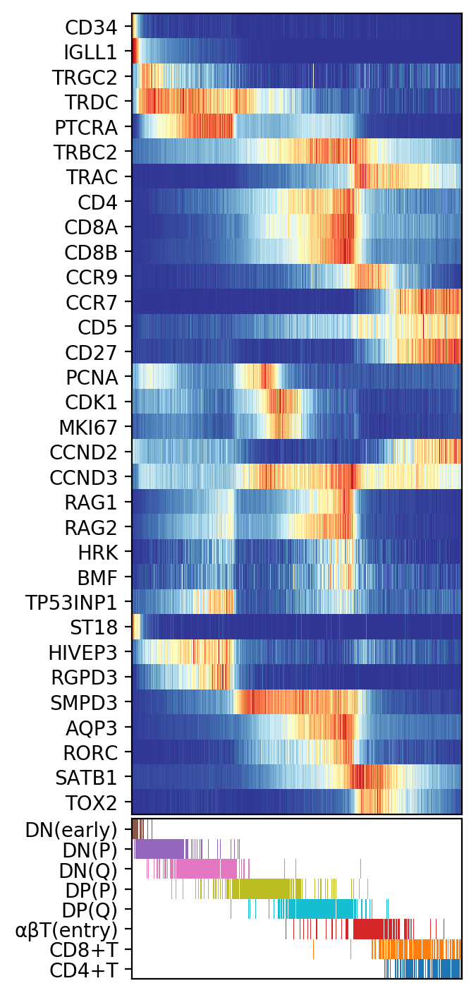

In [291]:
anno_order = ['DN(early)',
 'DN(P)','DN(Q)',
 'DP(P)','DP(Q)',
 'αβT(entry)',
   'CD8+T',   
 'CD4+T',
 ][::-1]
anno_order = [x for x in anno_order if x in set(T.obs[anno])]

im = draw.draw_pseudo_heatmap_v2(T,gene_list,anno=anno,anno_list = anno_order,figsize=(3,9),gridspec_kw={'height_ratios':[10,2]},fontsize=10,anno_window=3)
scjp.jp_save_fig(version,'Fig2_H',fig_folder=fig_folder)


In [505]:
gene_list = ['PTCRA','TRBC1','CD1A','CD5','CD4','CD8A','TRAC','CDK1','MKI67','PCNA',
             'CD34','ST18','IGLL1','FXYD2','HES1','MME','NDST3','CISH','DEFA6',
            'SH3TC1','ELOVL4','RORC','SATB1','CCR9','CCR7','GZMA']

0 0.0 0.175 CD4+T
1 0.175 0.35 CD8+T
2 0.35 0.5249999999999999 αβT(entry)
3 0.5249999999999999 0.7 DP(Q)
4 0.7 0.875 DP(P)
5 0.875 1.0499999999999998 DN(Q)
6 1.0499999999999998 1.2249999999999999 DN(P)
7 1.2249999999999999 1.4 DN(early)
02_Output/HTA08.v01.A06.Fig_Staal_pseudo.pdf


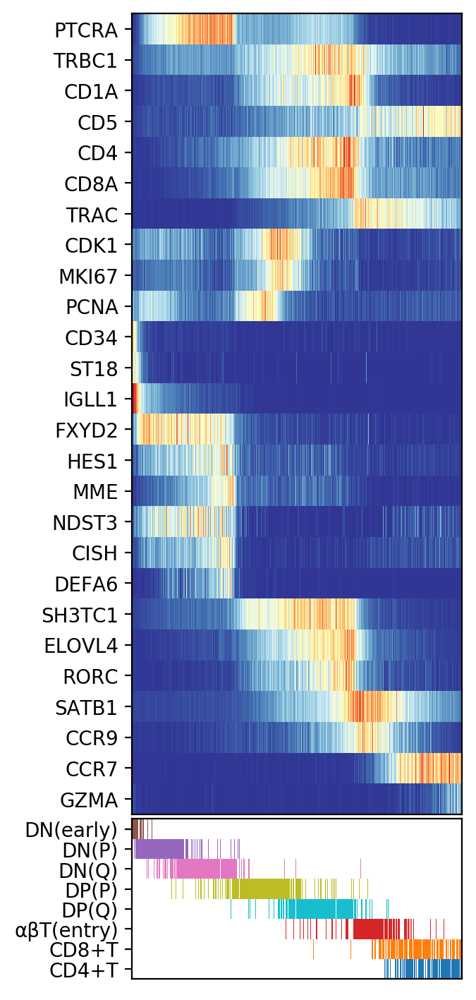

In [507]:
anno_order = ['DN(early)',
 'DN(P)','DN(Q)',
 'DP(P)','DP(Q)',
 'αβT(entry)',
   'CD8+T',   
 'CD4+T',
 ][::-1]
anno_order = [x for x in anno_order if x in set(T.obs[anno])]

im = draw.draw_pseudo_heatmap_v2(T,gene_list,anno=anno,
                                 anno_list = anno_order,figsize=(3,9),
                                 gridspec_kw={'height_ratios':[10,2]},fontsize=10,
                                 anno_window=3,mean_window=50)
scjp.jp_save_fig(version,'Fig_Staal_pseudo',fig_folder=fig_folder)


array([[-1.4374185e-01, -1.5703729e-01, -5.7783127e-01, ...,
         6.0436584e-02, -4.2379293e-01, -1.0561639e-02],
       [-1.4241584e-01, -1.5759386e-01, -5.7142520e-01, ...,
         6.4407699e-02, -4.1785526e-01, -1.1241402e-02],
       [-1.7259473e-01, -1.4492683e-01, -7.1722102e-01, ...,
        -2.5971306e-02, -5.5299139e-01,  4.2293747e-03],
       ...,
       [-2.5602570e-01, -2.8445539e-01, -8.3862054e-01, ...,
        -5.0842988e-01, -1.8662161e-01, -1.4277838e-01],
       [-2.6477465e-01, -2.8078318e-01, -8.8088709e-01, ...,
        -5.3463095e-01, -2.2579791e-01, -1.3829337e-01],
       [ 7.1509857e+00, -2.8041273e-01, -8.8515085e-01, ...,
         2.2639732e+00, -2.2974989e-01, -1.3784093e-01]], dtype=float32)

In [ ]:
tdata

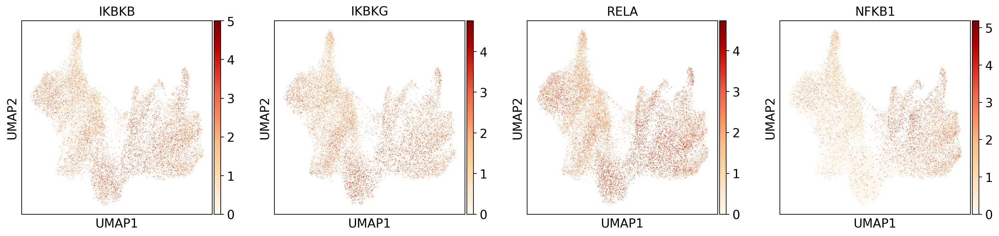

In [526]:
scjp.us(tdata,'IKBKB,IKBKG,RELA,NFKB1')

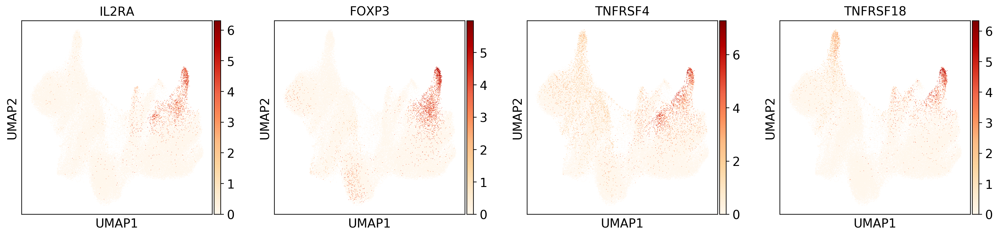

In [530]:
scjp.us(tdata,'IL2RA,FOXP3,TNFRSF4,TNFRSF18')

02_Output/HTA08.v01.A06.Fig_PTCRA_individual_genes.pdf


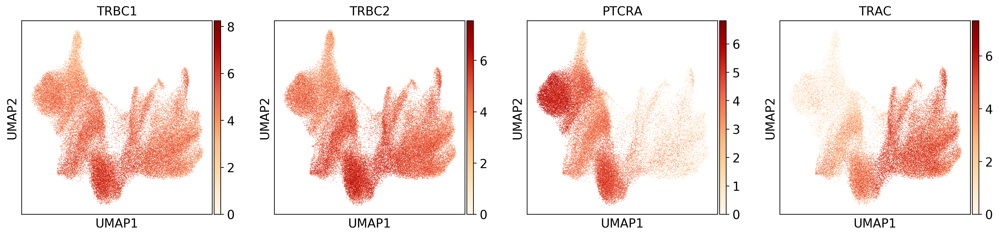

In [504]:
scjp.us(tdata,'TRBC1,TRBC2,PTCRA,TRAC')
scjp.jp_save_fig(version,'Fig_PTCRA_individual_genes',fig_folder=fig_folder)

02_Output/HTA08.v01.A06.Fig_Staal_individual_genes.pdf


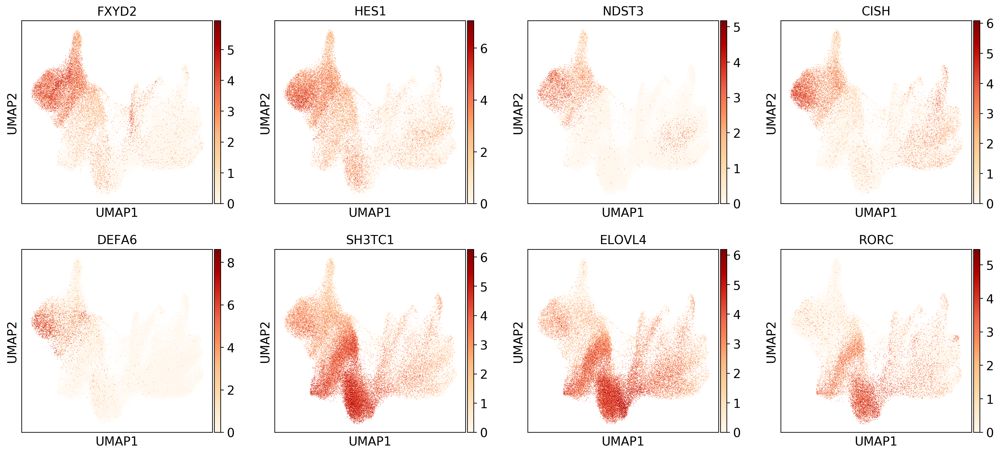

In [503]:
scjp.us(tdata,'FXYD2,HES1,NDST3,CISH,DEFA6,SH3TC1,ELOVL4,RORC')
scjp.jp_save_fig(version,'Fig_Staal_individual_genes',fig_folder=fig_folder)

In [499]:
mk = markers.marker(tdata,'Anno_level_5')

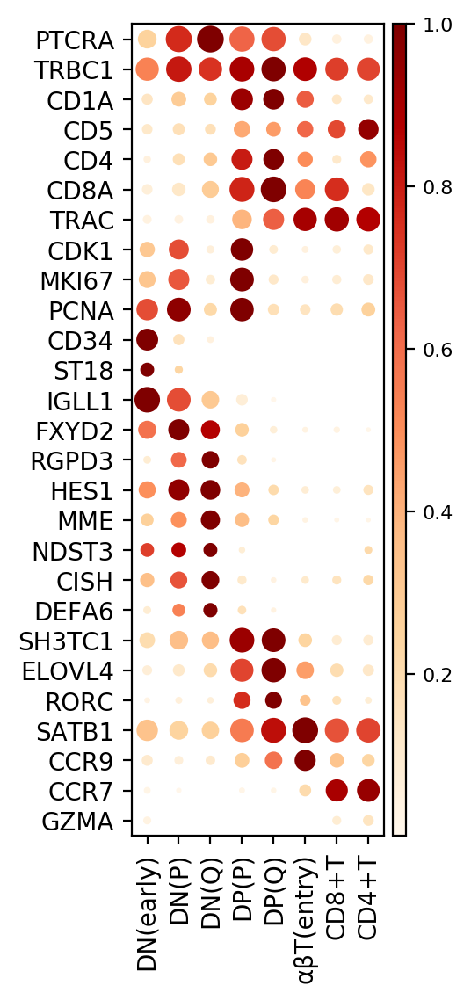

In [501]:
markers.draw_marker_blob_v2(tdata,tdata.uns['cdm_Anno_level_5'],gene_list, ctlist = anno_order[::-1])

02_Output/HTA07.A05.v02.Fig2H_colorbar.pdf


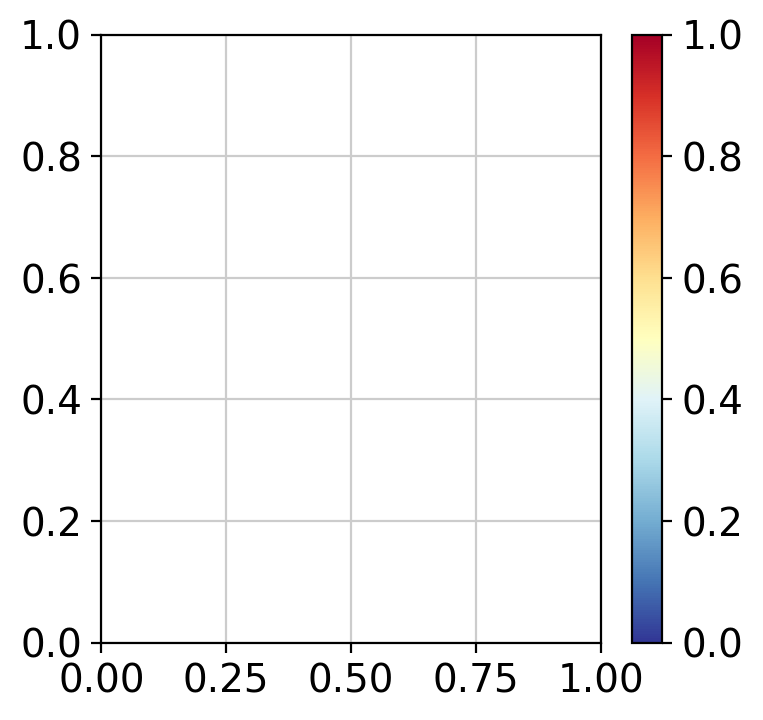

In [292]:
cbar = plt.colorbar(im)
scjp.jp_save_fig(version,'Fig2H_colorbar',fig_folder=fig_folder)

## mature lymphocyte analysis

In [71]:
cmap = matplotlib.cm.get_cmap('tab20')

In [75]:
cs={x:y for x,y in zip(sorted(set(tdata.obs[fig3_anno_key])),tdata.uns[fig3_anno_key+'_colors'])}

In [114]:
ct_t = ['CD4+T', 'CD4+T(out)', 'CD8+T', 'CD8+T(out)', 'CD8αα(I)', 'CD8αα(II)', 'DN(P)', 'DN(Q)', 'DN(early)', 'DP(P)', 'DP(Q)', 'IL10+T', 'NKT', 'Th17', 'Treg(I)', 'Treg(II)', 'Treg(III)', 'αβT(entry)', 'γδT']
ct_t1 = ['CD4+T', 'CD8+T', 'DN(P)', 'DN(Q)', 'DP(P)', 'DP(Q)', 'αβT(entry)', 'γδT']
ct_t3 = ['CD4+T', 'CD4+T(mem)', 'CD8+T', 'CD8+T(mem)', 'CD8αα(I)', 'CD8αα(II)', 'DP(P)', 'DP(Q)', 'Treg', 'Treg(diff)', 'T(agonist)', 'αβT(entry)']
ct_t2 = ['Th17','CD4+T', 'CD4+T(mem)', 'CD8+T', 'CD8+T(mem)', 'CD8αα(I)', 'CD8αα(II)', 'NKT', 'Treg', 'Treg(diff)', 'T(agonist)', 'αβT(entry)', 'γδT']

cs['CD4+T(mem)'] = 'blue'
cs['CD8+T(mem)'] = 'red'
cs['Th1'] = 'green'
cs['Tfh'] = 'skyblue'
cs['ILC3'] = 'green'
cs['NK'] = 'skyblue'

group_key = 'anno_final_v8'

CD4+T 0.0849767981438515 0.511600928074246 0.05162412993039443 0.6553074245939675 6896
CD8+T 0.10498687664041995 0.5686274509803921 0.06885903967886367 0.7522000926354794 6477
DN(P) 0.0010479983232026828 0.004191993292810731 0.034374345001047996 0.06308949905680152 4771
DN(Q) 0.0010824184320395857 0.010360290706664605 0.09850007731560229 0.07901654553888975 6467
DP(P) 0.04105775922059847 0.09580143818139643 0.06309440964973324 0.6675558648418773 25866
DP(Q) 0.06624189827529386 0.19943974513896517 0.06250686586839503 0.6685158738877294 18206
αβT(entry) 0.10096525096525097 0.5167953667953668 0.06177606177606178 0.7277992277992278 5180
γδT 0.008097165991902834 0.032388663967611336 0.10526315789473684 0.2793522267206478 494
02_Output/HTA07.A05.v02.Fig2_trb_dndp.pdf


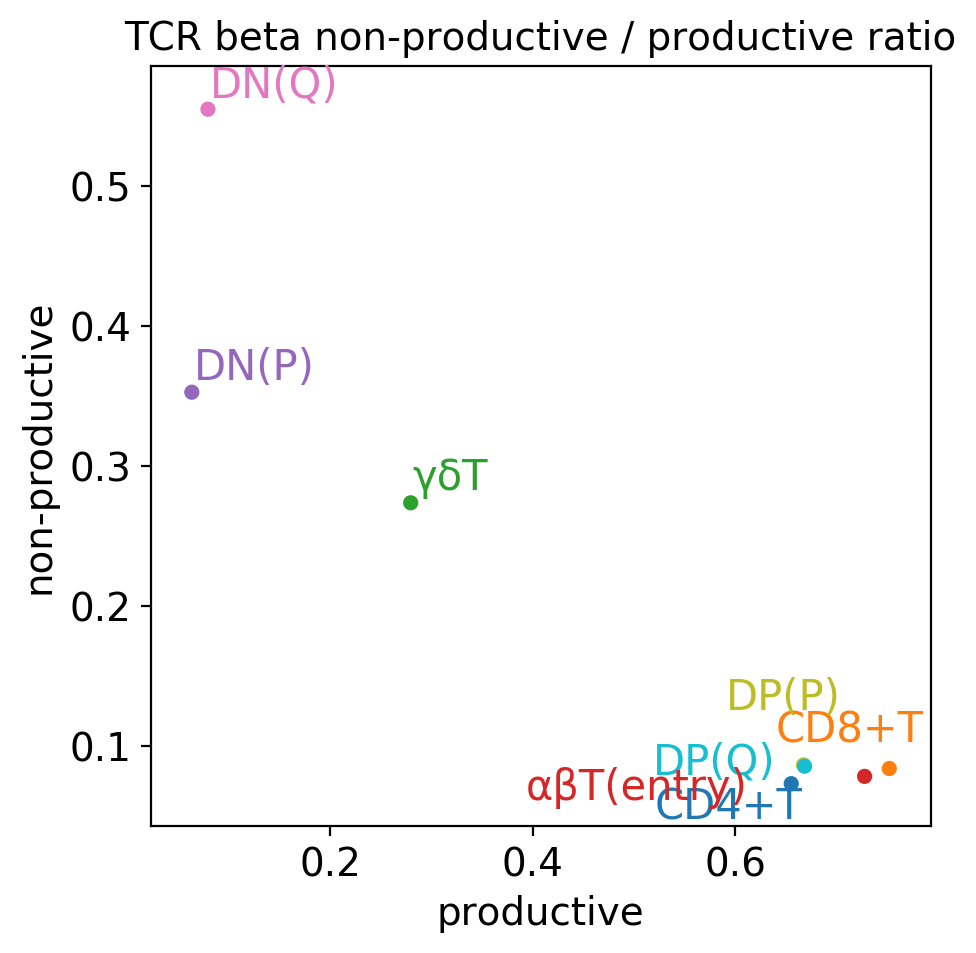

In [99]:
uniq_len = len(set(fig1.obs[group_key]))
color_list = [cmap(i/uniq_len) for i in range(uniq_len)]

#cs = {x:y for x,y in zip(sorted(set(mgd_all.obs[group_key])),color_list)}

ctlist = np.array(sorted([x for x in set(fig1.obs[group_key]) if x.split("/")[0] in ct_t1]))
P = 1


tra_dt = {}
trb_dt = {}

c_5gex = (fig1.obs['method']=='5GEX') & (fig1.obs['donor']!='F67')
ct_selected = []

for ct in ctlist:
    c1 = fig1.obs[group_key]==ct
    ct_size = np.sum(c1&c_5gex)
    if ct_size < 10:
        continue
    tra_p = np.sum(fig1.obs['is_TRA_p']&c1&c_5gex)/ct_size
    tra_np = np.sum(fig1.obs['is_TRA_np']&c1&c_5gex)/ct_size
    trb_p = np.sum(fig1.obs['is_TRB_p']&c1&c_5gex)/ct_size
    trb_np = np.sum(fig1.obs['is_TRB_np']&c1&c_5gex)/ct_size
    print(ct,tra_np,tra_p,trb_np,trb_p,ct_size)
    if np.sum(fig1.obs['is_TRB_p']&c1&c_5gex) < 20:
        continue
    ct_selected.append(ct)
    #tra_dt[ct],trb_dt[ct] = (tra_np/(tra_p+p)), (trb_np/(trb_p+p))
    tra_dt[ct],trb_dt[ct] = (((trb_p))), ((trb_np/(trb_p+trb_np)))

    if trb_p < 0.01:
        trb_dt[ct] = 0
    else:
        pass
    
from adjustText import adjust_text
x1 = []
y1 = []
cls = []

for ct in ct_selected:
    x1.append(tra_dt[ct])
    y1.append(trb_dt[ct])
    cls.append(cs[ct])
plt.figure(figsize=(5,5))
plt.scatter(x1,y1,color=cls,s=20)

texts = []
for i, txt in enumerate(ct_selected):
    texts.append(plt.text(x1[i],y1[i],txt,fontsize=15,color=cs[txt]))

plt.title('TCR beta non-productive / productive ratio')
plt.xlabel("productive")
plt.ylabel("non-productive")
plt.grid(False)
adjust_text(texts,only_move={'texts':'xy'},lim=4)
scjp.jp_save_fig(version,'Fig2_trb_dndp',fig_folder=fig_folder)

CD4+T 0.0849767981438515 0.511600928074246 0.05162412993039443 0.6553074245939675 6896
CD8+T 0.10498687664041995 0.5686274509803921 0.06885903967886367 0.7522000926354794 6477
DP(P) 0.04105775922059847 0.09580143818139643 0.06309440964973324 0.6675558648418773 25866
DP(Q) 0.06624189827529386 0.19943974513896517 0.06250686586839503 0.6685158738877294 18206
αβT(entry) 0.10096525096525097 0.5167953667953668 0.06177606177606178 0.7277992277992278 5180
γδT 0.008097165991902834 0.032388663967611336 0.10526315789473684 0.2793522267206478 494
02_Output/HTA07.A05.v02.Fig2_tra_dndp.pdf


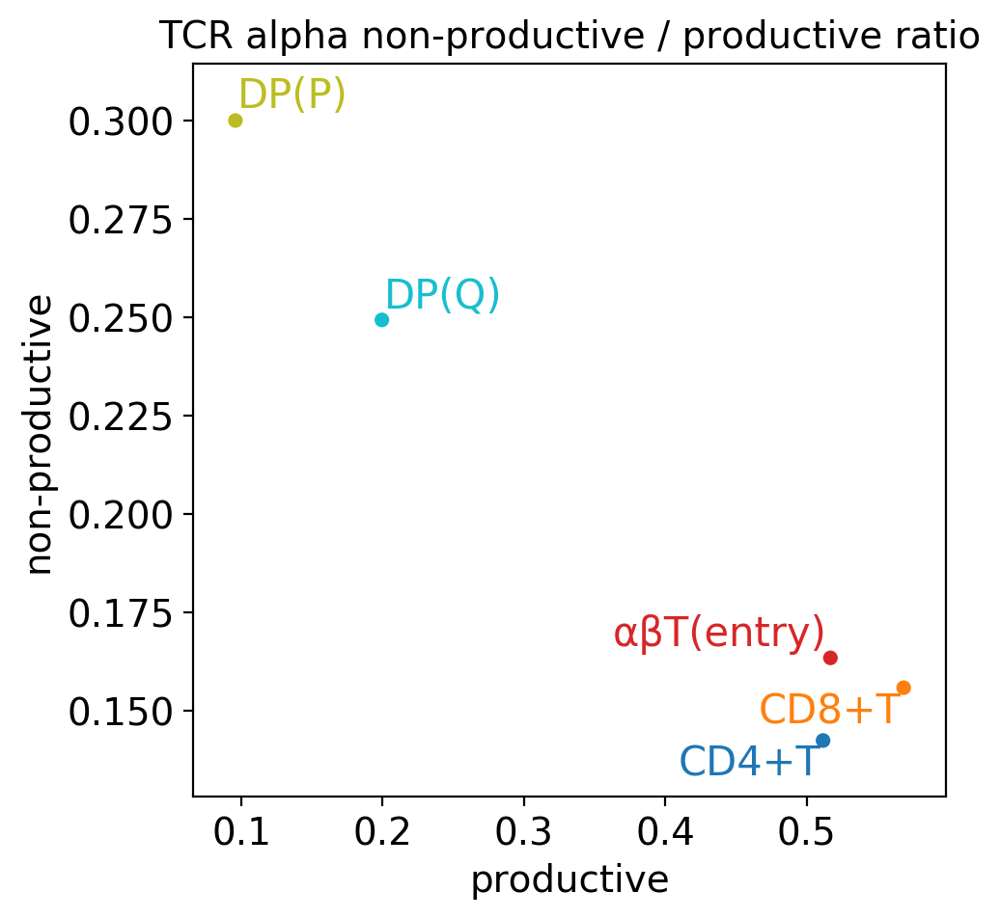

In [107]:

uniq_len = len(set(fig1.obs[group_key]))
color_list = [cmap(i/uniq_len) for i in range(uniq_len)]

#cs = {x:y for x,y in zip(sorted(set(mgd_all.obs[group_key])),color_list)}

ctlist = np.array(sorted([x for x in set(fig1.obs[group_key]) if (x.split("/")[0] in ct_t1) & (x.split("/")[0] not in ['DN(P)','DN(Q)'])]))
P = 1

tra_dt = {}
trb_dt = {}

c_5gex = (fig1.obs['method']=='5GEX') & (fig1.obs['donor']!='F67')
ct_selected = []

for ct in ctlist:
    c1 = fig1.obs[group_key]==ct
    ct_size = np.sum(c1&c_5gex)
    if ct_size < 10:
        continue
    tra_p = np.sum(fig1.obs['is_TRA_p']&c1&c_5gex)/ct_size
    tra_np = np.sum(fig1.obs['is_TRA_np']&c1&c_5gex)/ct_size
    trb_p = np.sum(fig1.obs['is_TRB_p']&c1&c_5gex)/ct_size
    trb_np = np.sum(fig1.obs['is_TRB_np']&c1&c_5gex)/ct_size
    print(ct,tra_np,tra_p,trb_np,trb_p,ct_size)

    if np.sum(fig1.obs['is_TRA_p']&c1&c_5gex) < 20:
        continue
    ct_selected.append(ct)
    #tra_dt[ct],trb_dt[ct] = (tra_np/(tra_p+p)), (trb_np/(trb_p+p))
    tra_dt[ct],trb_dt[ct] = (((tra_p))), ((tra_np/(tra_np+tra_p)))

    if tra_p < 0.01:
        trb_dt[ct] = 0
    else:
        pass
    
from adjustText import adjust_text

x1 = []
y1 = []
cls = []

for ct in ct_selected:
    x1.append(tra_dt[ct])
    y1.append(trb_dt[ct])
    cls.append(cs[ct])
plt.figure(figsize=(5,5))
plt.scatter(x1,y1,color=cls,s=20)

texts = []
for i, txt in enumerate(ct_selected):
    texts.append(plt.text(x1[i],y1[i],txt,fontsize=15,color=cs[txt]))

plt.title('TCR alpha non-productive / productive ratio')
plt.xlabel("productive")
plt.ylabel("non-productive")
plt.grid(False)
adjust_text(texts,only_move={'texts':'xy'},lim=4)
scjp.jp_save_fig(version,'Fig2_tra_dndp',fig_folder=fig_folder)

CD4+T 0.15144404332129963 0.9328519855595668 0.0756317689530686 0.9588447653429603 5540
CD8+T 0.16515926071569012 0.9152575697994495 0.09064097522611089 0.9530082579630358 5086
CD8αα(I) 0.15083798882681565 0.9301675977653632 0.06256983240223464 0.9497206703910615 1790
CD8αα(II) 0.14285714285714285 0.9477124183006536 0.059757236227824466 0.9645191409897292 1071
DP(P) 0.27756822720213004 0.6587530508098514 0.09008209451963613 0.958508986021744 4507
DP(Q) 0.24079270431427569 0.7316730971588916 0.09294984216064539 0.9515959312521922 5702
T(agonist) 0.14003164556962025 0.9287974683544303 0.07278481012658228 0.9462025316455697 1264
Treg 0.1074964639321075 0.9519094766619519 0.03536067892503536 0.9646393210749646 707
Treg(diff) 0.152089407191448 0.9217687074829932 0.06948493683187561 0.9285714285714286 2058
αβT(entry) 0.16449375866851595 0.8926490984743412 0.08155339805825243 0.950624133148405 3605
02_Output/HTA07.A05.v02.Fig3B_np_p_all.pdf


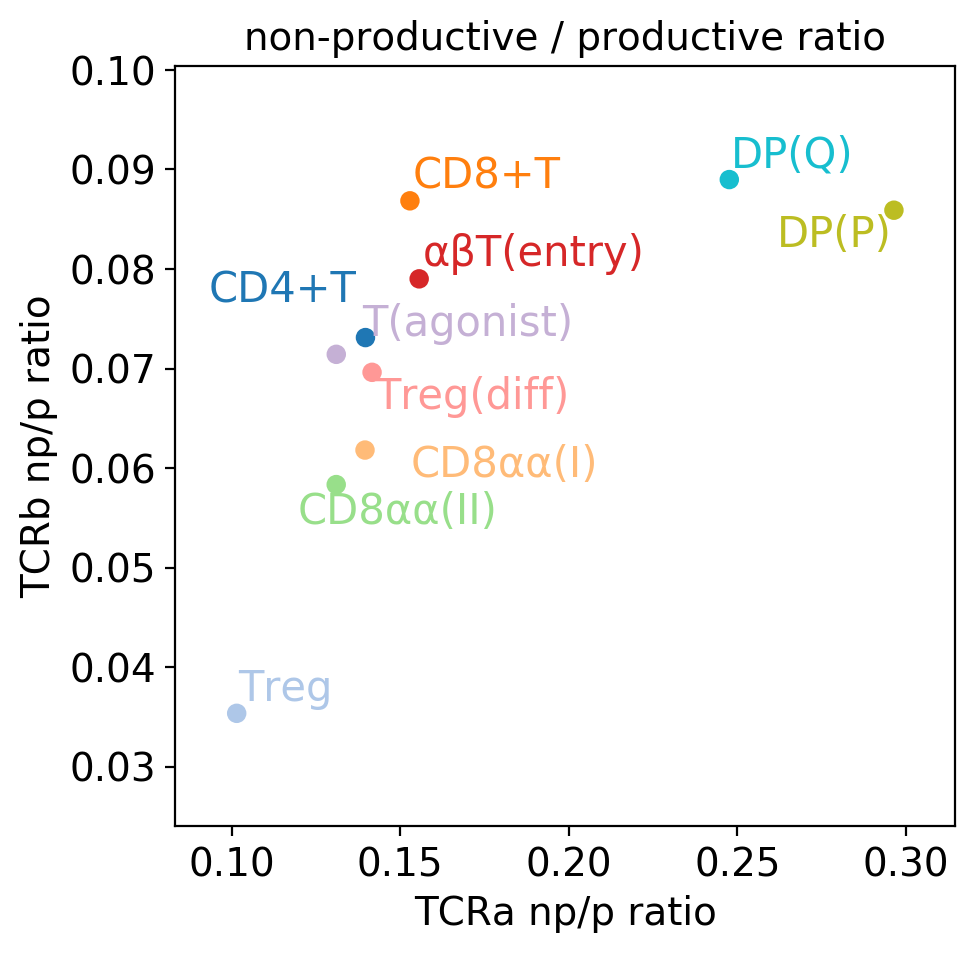

In [111]:
uniq_len = len(set(fig1.obs[group_key]))
color_list = [cmap(i/uniq_len) for i in range(uniq_len)]
ctlist = ['CD4+T',
 'CD8+T',
 'CD8αα(I)',
 'CD8αα(II)',
 'DP(P)',
 'DP(Q)',
 'Treg',
 'Treg(diff)',
 'T(agonist)',
 'αβT(entry)']

#cs = {x:y for x,y in zip(sorted(set(mgd_all.obs[group_key])),color_list)}

ctlist = np.array(sorted([x for x in set(fig1.obs[group_key]) if x.split("/")[0] in ctlist]))
p = 0.0001
P = 0.1

tra_dt = {}
trb_dt = {}

c_5gex = (fig1.obs['method']=='5GEX') & (fig1.obs['is_TRA_fl'])
ct_selected = []

for ct in ctlist:
    c1 = fig1.obs[group_key]==ct
    ct_size = np.sum(c1&c_5gex)
    if ct_size < 100:
        continue
    tra_p = np.sum(fig1.obs['is_TRA_p']&c1&c_5gex)/ct_size
    tra_np = np.sum(fig1.obs['is_TRA_np']&c1&c_5gex)/ct_size
    trb_p = np.sum(fig1.obs['is_TRB_p']&c1&c_5gex)/ct_size
    trb_np = np.sum(fig1.obs['is_TRB_np']&c1&c_5gex)/ct_size
    print(ct,tra_np,tra_p,trb_np,trb_p,ct_size)

    ct_selected.append(ct)
  
    tra_dt[ct],trb_dt[ct] = ((tra_np/(tra_p+tra_np))), ((trb_np/(trb_p+trb_np)))
    if tra_p < 0.05:
        tra_dt[ct] = 0
    elif trb_p < 0.05:
        trb_dt[ct] = 0
    else:
        pass
    
from adjustText import adjust_text

x1 = []
y1 = []
cls = []

for ct in ct_selected:
    x1.append(tra_dt[ct])
    y1.append(trb_dt[ct])
    cls.append(cs[ct])
plt.figure(figsize=(5,5))
plt.scatter(x1,y1,color=cls)

texts = []
for i, txt in enumerate(ct_selected):
    texts.append(plt.text(x1[i],y1[i],txt,fontsize=15,color=cs[txt]))

plt.title('non-productive / productive ratio')
plt.xlabel("TCRa np/p ratio")
plt.ylabel("TCRb np/p ratio")
plt.grid(False)
adjust_text(texts,only_move={'texts':'xy'},lim=4)
scjp.jp_save_fig(version,'Fig3B_np_p_all',fig_folder=fig_folder)

In [112]:
fig1.obs['is_TRDC'] = fig1.raw.X[:,fig1.raw.var_names=='TRDC'].todense().A1>0.0
fig1.obs['is_TRGC1'] = fig1.raw.X[:,fig1.raw.var_names=='TRGC1'].todense().A1>0.2
fig1.obs['is_TRGC2'] = fig1.raw.X[:,fig1.raw.var_names=='TRGC2'].todense().A1>0.2

CD4+T 0.511600928074246 0.03755800464037123 6896
CD8+T 0.5686274509803921 0.03643662189285163 6477
CD8αα(I) 0.6517013232514177 0.10113421550094517 2116
CD8αα(II) 0.5399120050282841 0.2972972972972973 1591
NKT 0.14646464646464646 0.41919191919191917 198
T(agonist) 0.5355285961871751 0.05199306759098787 1731
Th17 0.44285714285714284 0.2761904761904762 210
Treg 0.56 0.03024390243902439 1025
Treg(diff) 0.5187596899224807 0.04093023255813953 3225
αβT(entry) 0.5167953667953668 0.05057915057915058 5180
γδT 0.032388663967611336 0.8947368421052632 494
02_Output/HTA07.A05.v02.Fig3_TRDC_TCRa_ratio.pdf


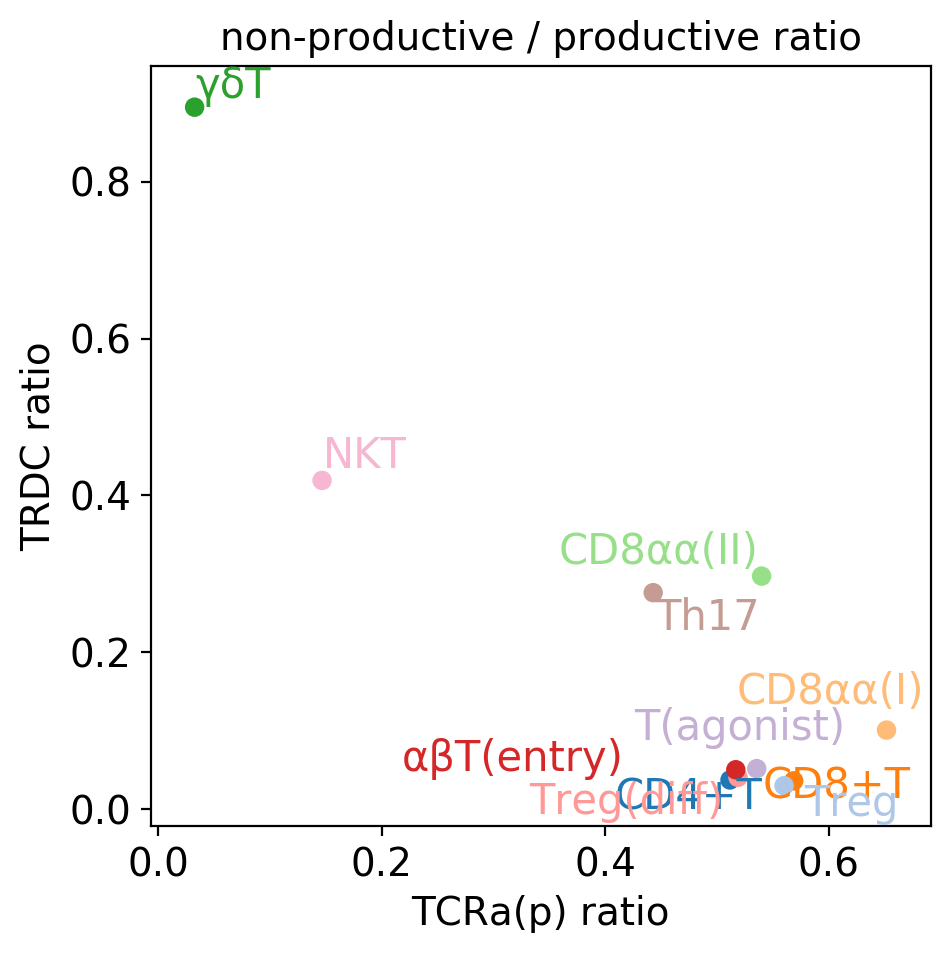

In [115]:
uniq_len = len(set(fig1.obs[group_key]))
color_list = [cmap(i/uniq_len) for i in range(uniq_len)]

ctlist = np.array(sorted([x for x in set(fig1.obs[group_key]) if x.split("/")[0] in ct_t2]))
p = 0.0001
P = 0.0001

tra_dt = {}
trb_dt = {}

c_5gex = (fig1.obs['method']=='5GEX') & (fig1.obs['donor']!='F67')
ct_selected = []

for ct in ctlist:
    c1 = fig1.obs[group_key]==ct
    ct_size = np.sum(c1&c_5gex)
    if ct_size < 10:
        continue
    tra_p = np.sum(fig1.obs['is_TRA_p']&c1&c_5gex)/ct_size
    trb_p = np.sum(fig1.obs['is_TRDC']&c1&c_5gex)/ct_size
    print(ct,tra_p,trb_p,ct_size)

    ct_selected.append(ct)
    #tra_dt[ct],trb_dt[ct] = (tra_np/(tra_p+p)), (trb_np/(trb_p+p))
    tra_dt[ct],trb_dt[ct] = tra_p,trb_p
    if tra_p < 0.01:
        tra_dt[ct] = 0
    elif trb_p < 0.01:
        trb_dt[ct] = 0
    else:
        pass
    
from adjustText import adjust_text

x1 = []
y1 = []
cls = []

for ct in ct_selected:
    x1.append(tra_dt[ct])
    y1.append(trb_dt[ct])
    cls.append(cs[ct])
plt.figure(figsize=(5,5))
plt.scatter(x1,y1,color=cls)

texts = []
for i, txt in enumerate(ct_selected):
    texts.append(plt.text(x1[i],y1[i],txt,fontsize=15,color=cs[txt]))

plt.title('non-productive / productive ratio')
plt.xlabel("TCRa(p) ratio")
plt.ylabel("TRDC ratio")
plt.grid(False)
adjust_text(texts,only_move={'texts':'xy'},lim=4)
scjp.jp_save_fig(version,'Fig3_TRDC_TCRa_ratio',fig_folder=fig_folder)

02_Output/HTA07.A05.v02.Fig3_DV1DV2_fetus.pdf


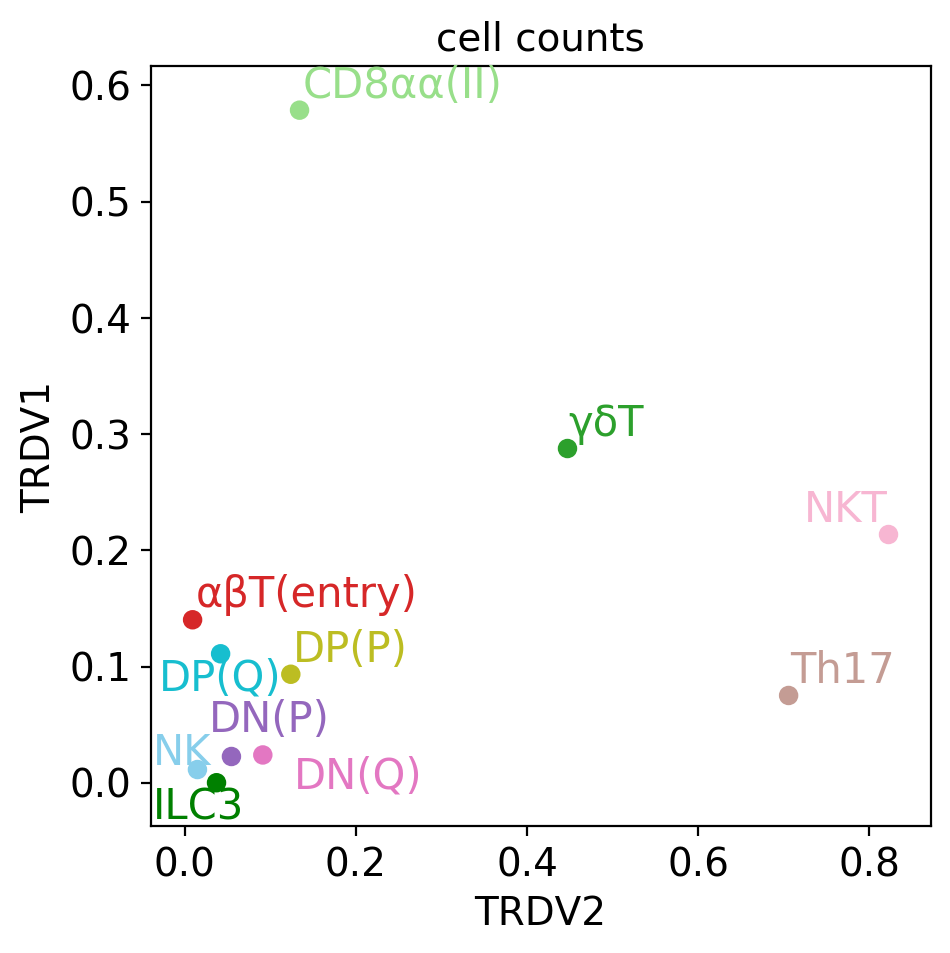

In [117]:
# Draw TRDV1/TRDV2 ratio

ctlist = [
 'CD8αα(II)',
 'Th17',
 'NKT',
 'αβT(entry)',
 'γδT','DN(P)','DN(Q)','DP(P)','DP(Q)','NK','ILC3']

uniq_len = len(set(fig1.obs[group_key]))
color_list = [cmap(i/uniq_len) for i in range(uniq_len)]

ctlist = np.array(sorted([x for x in set(fig1.obs[group_key]) if x.split("/")[0] in ctlist]))
p = 0.0001
P = 0.0001

tra_dt = {}
trb_dt = {}

c_5gex = (fig1.obs['method']=='5GEX') & (fig1.obs['donor']!='F67') 
ct_selected = []

gx = np.sum(fig1.raw.X[:,fig1.raw.var_names.isin('TRDV2'.split(','))],axis=1).A1
gy = np.sum(fig1.raw.X[:,fig1.raw.var_names.isin('TRDV1'.split(','))],axis=1).A1

x1 = []
y1 = []
cls = []

for ct in ctlist:
    c1 = fig1.obs[group_key]==ct
    ct_size = np.sum(c1)
    if ct_size < 10:
        continue
    x1.append(np.mean(gx[c1]))
    y1.append(np.mean(gy[c1]))
    cls.append(ct)

plt.figure(figsize=(5,5))
plt.scatter(x1,y1,color=[cs[txt] for txt in cls])

texts = []
for i, txt in enumerate(cls):
    texts.append(plt.text(x1[i],y1[i],txt,fontsize=15,color=cs[txt]))

plt.title('cell counts')
plt.xlabel("TRDV2")
plt.ylabel("TRDV1")
plt.grid(False)
adjust_text(texts,only_move={'texts':'xy'},lim=4)
scjp.jp_save_fig(version,'Fig3_DV1DV2_fetus',fig_folder=fig_folder)

02_Output/HTA07.A05.v02.Fig3_innate_genes_fetus.pdf


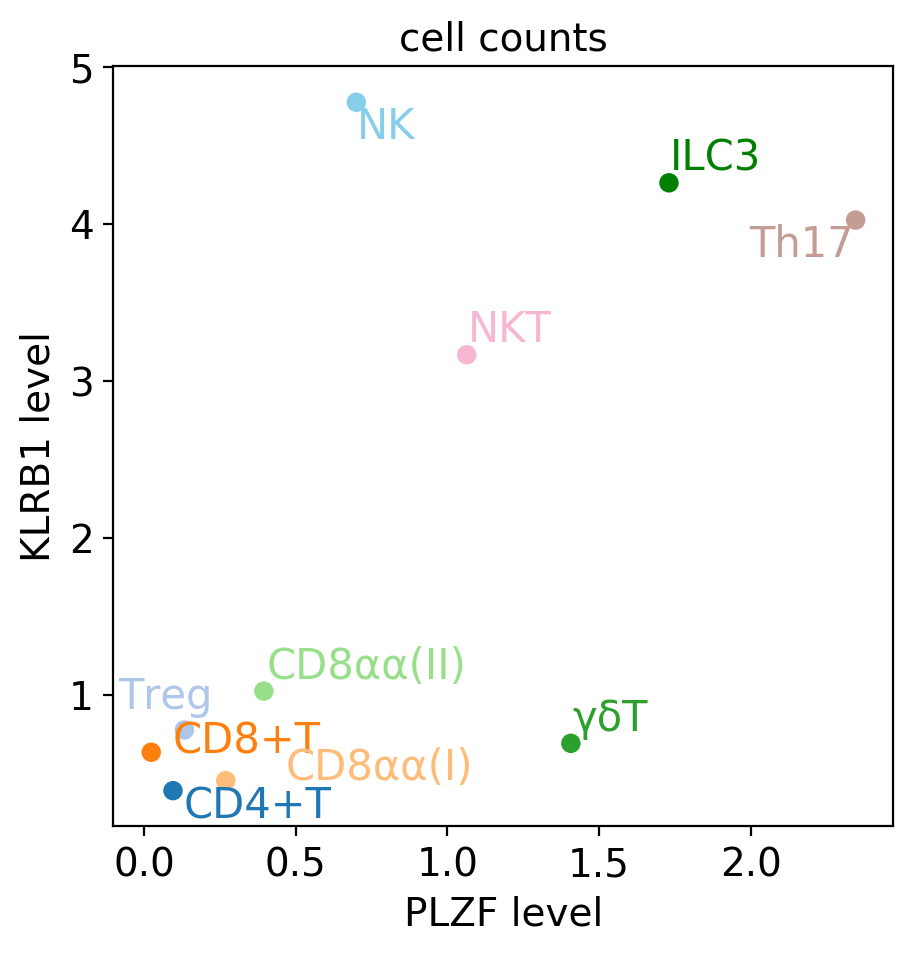

In [119]:
# Draw TRDV1/TRDV2 ratio

ctlist = ['CD4+T',
 'CD8+T',
 'CD8αα(I)',
 'CD8αα(II)',
 'Th17',
 'NKT',
 'Treg',
 'γδT','ILC3','NK']

uniq_len = len(set(fig1.obs[group_key]))
color_list = [cmap(i/uniq_len) for i in range(uniq_len)]

ctlist = np.array(sorted([x for x in set(fig1.obs[group_key]) if x.split("/")[0] in ctlist]))
p = 0.0001
P = 0.0001

tra_dt = {}
trb_dt = {}

c_5gex = (fig1.obs['method']=='5GEX') & (fig1.obs['donor']!='F67')  
ct_selected = []

gx = np.sum(fig1.raw.X[:,fig1.raw.var_names.isin('ZBTB16'.split(','))],axis=1).A1
gy = np.sum(fig1.raw.X[:,fig1.raw.var_names.isin('KLRB1'.split(','))],axis=1).A1

x1 = []
y1 = []
cls = []

for ct in ctlist:
    c1 = fig1.obs[group_key]==ct
    ct_size = np.sum(c1)
    if ct_size < 10:
        continue
    x1.append(np.mean(gx[c1]))
    y1.append(np.mean(gy[c1]))
    cls.append(ct)

plt.figure(figsize=(5,5))
plt.scatter(x1,y1,color=[cs[txt] for txt in cls])

texts = []
for i, txt in enumerate(cls):
    texts.append(plt.text(x1[i],y1[i],txt,fontsize=15,color=cs[txt]))

plt.title('cell counts')
plt.xlabel("PLZF level")
plt.ylabel("KLRB1 level")
plt.grid(False)
adjust_text(texts,only_move={'texts':'xy'},lim=4)
scjp.jp_save_fig(version,'Fig3_innate_genes_fetus',fig_folder=fig_folder)

02_Output/HTA07.A05.v02.Fig3_CD8AB_fetus.pdf


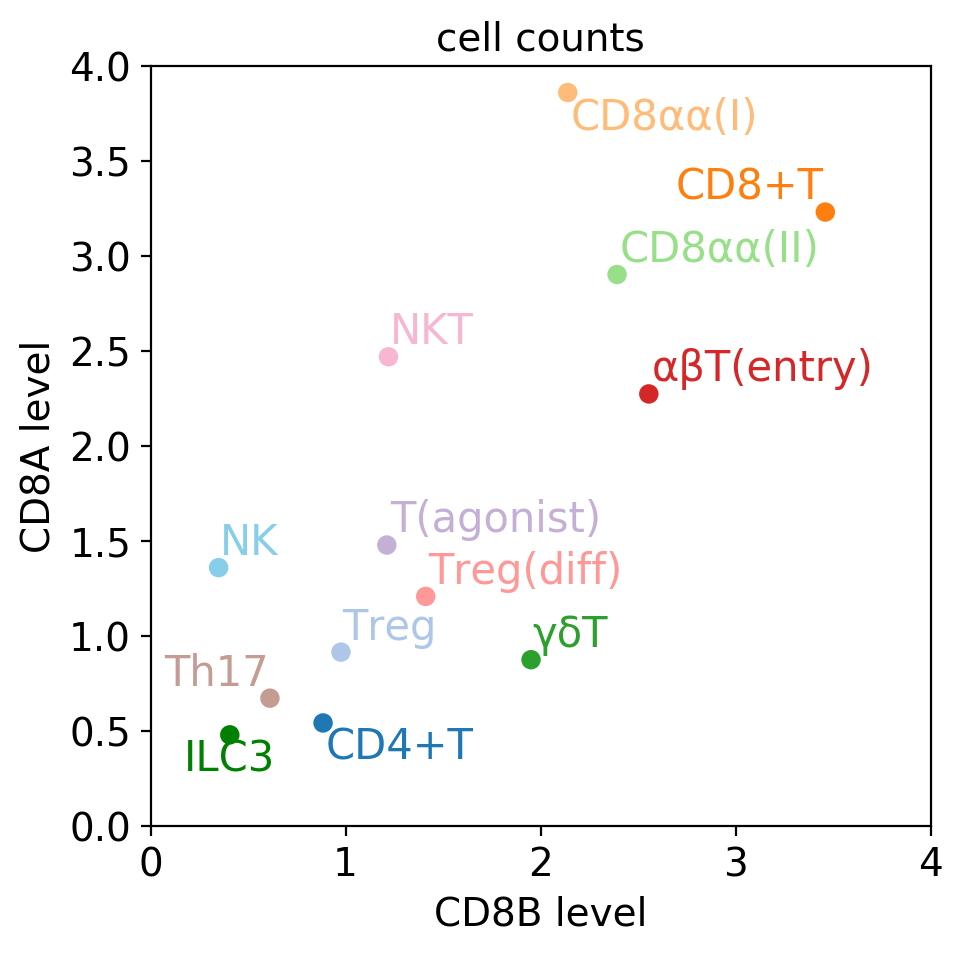

In [122]:
# Draw TRDV1/TRDV2 ratio


uniq_len = len(set(fig1.obs[group_key]))
color_list = [cmap(i/uniq_len) for i in range(uniq_len)]

ctlist = np.array(sorted([x for x in set(fig1.obs[group_key]) if x.split("/")[0] in ct_t2+['NK','ILC3']]))
p = 0.0001
P = 0.0001

tra_dt = {}
trb_dt = {}

c_5gex = (fig1.obs['method']=='5GEX') & (fig1.obs['donor']!='F67') 
ct_selected = []

gx = np.sum(fig1.raw.X[:,fig1.raw.var_names.isin('CD8B'.split(','))],axis=1).A1
gy = np.sum(fig1.raw.X[:,fig1.raw.var_names.isin('CD8A'.split(','))],axis=1).A1

x1 = []
y1 = []
cls = []

for ct in ctlist:
    c1 = fig1.obs[group_key]==ct
    ct_size = np.sum(c1)
    if ct_size < 10:
        continue
    x1.append(np.mean(gx[c1]))
    y1.append(np.mean(gy[c1]))
    cls.append(ct)

plt.figure(figsize=(5,5))
plt.scatter(x1,y1,color=[cs[txt] for txt in cls])

texts = []
for i, txt in enumerate(cls):
    texts.append(plt.text(x1[i],y1[i],txt,fontsize=15,color=cs[txt]))

plt.title('cell counts')
plt.xlabel("CD8B level")
plt.ylabel("CD8A level")
plt.ylim(0,4)
plt.xlim(0,4)
plt.grid(False)
adjust_text(texts,only_move={'texts':'xy'},lim=4)
scjp.jp_save_fig(version,'Fig3_CD8AB_fetus',fig_folder=fig_folder)

In [123]:
print(set(Tfsl.obs['anno_final_print_v2']))

{'ILC3', 'γδT', 'CD8αα(II)', 'αβT(entry)', 'CD8αα(I)', 'Treg', 'NK', 'CD8+T', 'T(agonist)', 'Th17', 'CD4+T', 'NKT', 'Treg(diff)'}


In [124]:
print(set(fig1.obs['anno_final_v8']))

{'CD8αα(II)', 'DP(P)', 'CD8αα(I)', 'CD8+Tmem', 'Endo', 'Epi_GCM2', 'mTEC(II)', 'Tfh', 'ETP', 'Mono', 'DN(P)', 'Lymph', 'Fb_cycling', 'B_plasma', 'aDC2', 'TEC(myo)', 'NMP', 'mTEC(IV)', 'DP(Q)', 'CD4+T', 'Fb_1', 'NKT', 'B_pro/pre', 'mTEC(I)', 'aDC3', 'Ery', 'cTEC', 'Treg', 'DC1', 'B_memory', 'CD4+PD1', 'T(agonist)', 'pDC', 'DN(Q)', 'VSMC', 'DN(early)', 'Mast', 'B_naive', 'DC2', 'Treg(diff)', 'ILC3', 'γδT', 'Mac', 'Fb_2', 'mcTEC', 'CD4+CTL', 'αβT(entry)', 'Mgk', 'CD4+Tmem', 'CD8+T', 'NK', 'mTEC(III)', 'TEC(neuro)', 'Th17', 'aDC1'}


In [169]:
c_fig1_show = (fig1.obs['method']=='5GEX') & (fig1.obs['donor']!='F67') & (fig1.obs['birth']=='prenatal')
TH = fig1[c_fig1_show]
c_Tfsl_show = (Tfsl.obs['organ']=='LI')
LI = Tfsl[c_Tfsl_show]

In [170]:
TH.obs['isYoung'] = TH.obs['Order'] < 10
LI.obs['isYoung'] = LI.obs['stage'] < 5

Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.


CD4+T 730 2133
CD8+T 388 1937
CD8αα(I) 8 638
CD8αα(II) 17 333
ILC3 2115 83
NK 16802 219
NKT 441 125
T(agonist) 0 531
Th17 342 165
Treg 216 227
Treg(diff) 1 466
αβT(entry) 2 2374
γδT 264 319
02_Output/HTA07.A05.v02.Fig3_Thymus_Liver_ratio.pdf


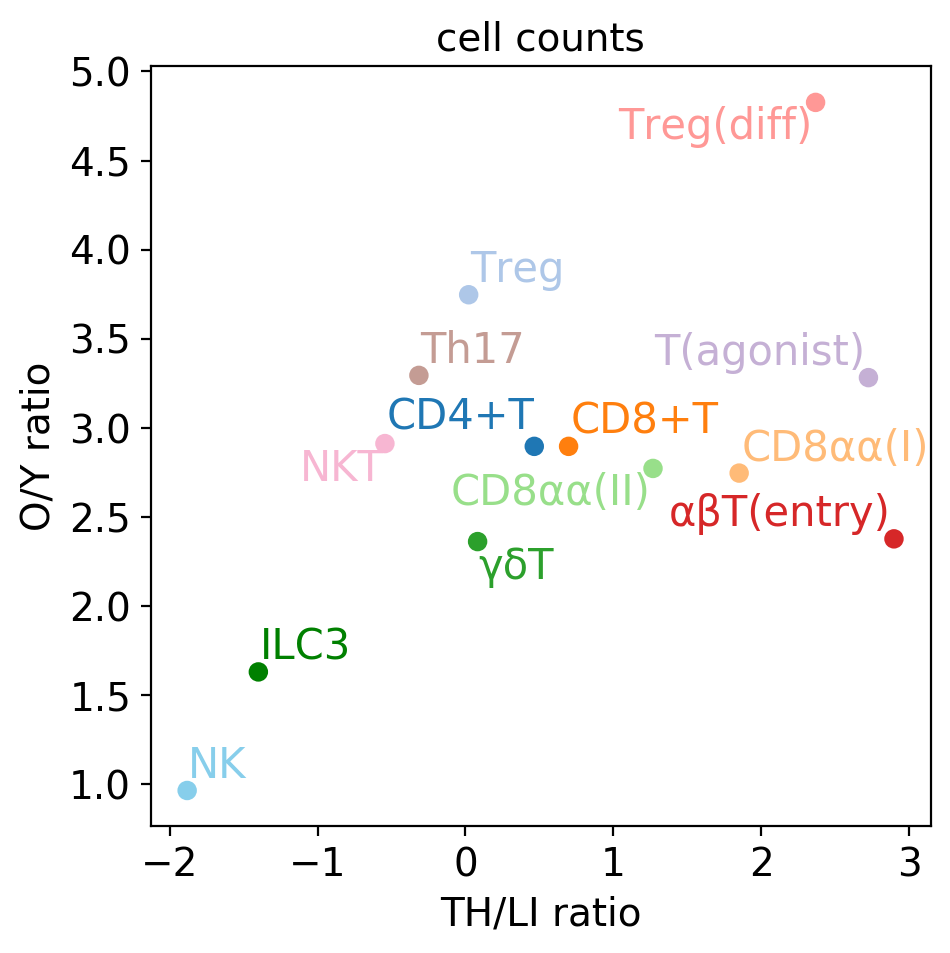

In [179]:
uniq_len = len(set(adata.obs[group_key]))
color_list = [cmap(i/uniq_len) for i in range(uniq_len)]

ctlist = np.array(sorted([x for x in set(adata.obs[group_key]) if x.split("/")[0] in ct_t2+['NK','ILC3']]))
p = 0.0001
P = 0.0001

ct_selected = []

x1 = []
y1 = []
cls = []

for ct in ctlist:
    c_LI = LI.obs['anno_final_print_v2']==ct
    c_TH = TH.obs['anno_final_v8']==ct
    
    print(ct,np.sum(c_LI),np.sum(c_TH))
    ct_size = np.sum(c_LI) + np.sum(c_TH)
    if ct_size < 10:
        continue
    
    c_LI_YO = (LI.obs['isYoung']) & c_LI
    c_TH_YO = (TH.obs['isYoung']) & c_TH
    
    LI_ratio = (np.log10(np.sum(c_TH)+1))-(np.log10(np.sum(c_LI)+1))
    YO_ratio = (np.log10(np.sum(~c_TH_YO) + np.sum(~c_LI_YO) +1))-(np.log10(np.sum(c_LI_YO) + np.sum(c_TH_YO)+1))
       
    y1.append(YO_ratio) # y1: ratio of DJ pair detected
    x1.append(LI_ratio)
    cls.append(ct)

plt.figure(figsize=(5,5))
plt.scatter(x1,y1,color=[cs[txt] for txt in cls])

texts = []
for i, txt in enumerate(cls):
    texts.append(plt.text(x1[i],y1[i],txt,fontsize=15,color=cs[txt]))

plt.title('cell counts')
plt.xlabel("TH/LI ratio")
plt.ylabel("O/Y ratio")
plt.grid(False)
adjust_text(texts,only_move={'texts':'xy'},lim=4)
scjp.jp_save_fig(version,'Fig3_Thymus_Liver_ratio',fig_folder=fig_folder)

## Merge with SS2 data

In [180]:
dat = pd.read_csv("/mnt/02_FCA_ImmunoP/02_FCA_union_cells/01_Matrix/SS2/28284_5/countMatrix.txt",sep='\t')

In [181]:
meta = pd.read_csv("/mnt/02_FCA_ImmunoP/02_FCA_union_cells/01_Matrix/SS2/28284_5_ID_covert.csv",header=None)

In [182]:
ID_convert = {x:y for x,y in zip(meta.iloc[:,0],meta.iloc[:,1])}

In [183]:
X = np.array(dat.iloc[:,1:]).T

In [196]:
ss2 = sc.AnnData(scipy.sparse.csr_matrix(X))
ss2.obs_names = dat.columns[1:]
ss2.var = tdata.raw.var

In [197]:
ss2.obs['Sample'] = 'SS2_28284_5'
ss2.obs['fetus'] = 'F100'
ss2.obs['sort'] = [ID_convert[int(x.split("#")[1])] for x in ss2.obs_names]
ss2.obs['method'] = 'SS2'
ss2.obs['file'] = '28284_5'
ss2.obs['organ'] = 'TH'

In [198]:
# caculate n_counts / n_genes per cell
ss2.obs['n_counts'] = np.sum(ss2.X, axis=1).A1
ss2.obs['n_genes'] = np.sum(ss2.X>0,axis=1)

# filter cells
clist = []
clist.append(np.array(ss2.obs['n_counts'] > 2000))
clist.append(np.array(ss2.obs['n_genes'] > 500))
clist.append(np.array(ss2.obs['n_genes'] < 7000))

c = np.column_stack(clist).all(axis=1)
ss2 = ss2[c].copy()

ss2 = ss2[:,np.argsort(ss2.var.GeneID)]

ss2 = ss2

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [199]:
sc.pp.normalize_per_cell(ss2,counts_per_cell_after=1e4)
sc.pp.log1p(ss2)

Trying to set attribute `.obs` of view, making a copy.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [200]:
ss2.raw = ss2

In [202]:
scjp.sc_process(ss2,pid='fpnul')

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:00.19)
computing neighbors
    using 'X_pca' with n_pcs = 50


/home/ubuntu/.local/lib/python3.6/site-packages/umap/umap_.py:349: NumbaWarning:


Compilation is falling back to object mode WITH looplifting enabled because Function "fuzzy_simplicial_set" failed type inference due to: Untyped global name 'nearest_neighbors': cannot determine Numba type of <class 'function'>

File "../../home/ubuntu/.local/lib/python3.6/site-packages/umap/umap_.py", line 467:
def fuzzy_simplicial_set(
    <source elided>
    if knn_indices is None or knn_dists is None:
        knn_indices, knn_dists, _ = nearest_neighbors(
        ^


/home/ubuntu/.local/lib/python3.6/site-packages/numba/compiler.py:725: NumbaWarning:

Function "fuzzy_simplicial_set" was compiled in object mode without forceobj=True.

File "../../home/ubuntu/.local/lib/python3.6/site-packages/umap/umap_.py", line 350:
@numba.jit()
def fuzzy_simplicial_set(
^


/home/ubuntu/.local/lib/python3.6/site-packages/numba/compiler.py:734: NumbaDeprecationWarning:


Fall-back from the nopython compilation path

    finished (0:00:02.26) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:00:00.60) --> added
    'X_umap', UMAP coordinates (adata.obsm)
running Leiden clustering
    finished (0:00:00.02) --> found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


In [209]:
ss2s = scjp.get_subset(ss2,ss2.obs.sort=='T CD137+CD4-')

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 35
    finished (0:00:00.02)


creating lr model...


/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.



making lr prediction...
updating lr to adata...


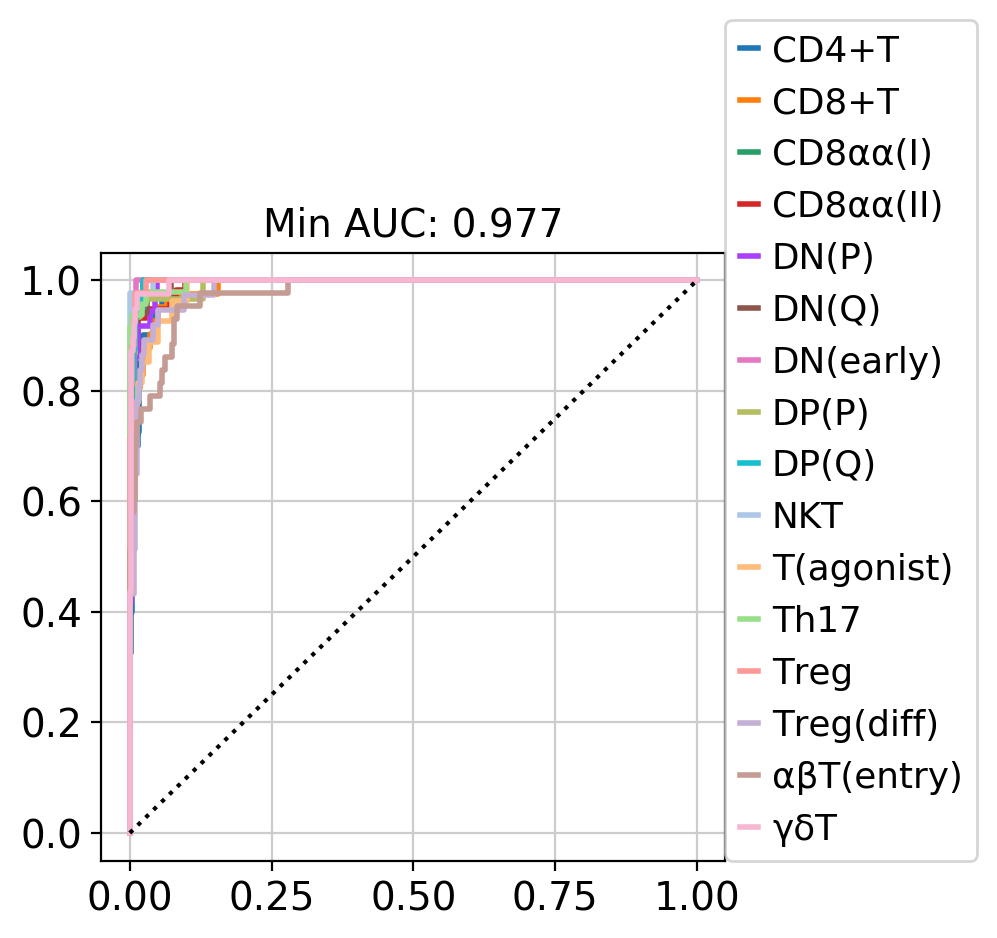

In [212]:
lr = scjp.model.transfer_annotation_jp(tdata,fig3_anno_key,ss2s,fig3_anno_key)

In [250]:
Counter(ss2s.obs[fig3_anno_key])

Counter({'Th17': 1,
         'CD8αα(I)': 18,
         'γδT': 4,
         'CD8αα(II)': 3,
         'NKT': 6,
         'T(agonist)': 1,
         'DP(P)': 2})

In [241]:
ad = {}
ad['ss2'] = sc.AnnData(ss2s.raw.X)
ad['tdata'] = sc.AnnData(tdata.raw.X)

ad['ss2'].obs_names = ss2s.obs_names
ad['tdata'].obs_names = tdata.obs_names

for obskey in [fig3_anno_key, 'method', 'Sample']:
    ad['ss2'].obs[obskey] = ss2s.obs[obskey]
    ad['tdata'].obs[obskey] = tdata.obs[obskey]

In [242]:
tss2 = scjp.merge_matrix(ad)

77029
anno_final_v2_epi
method
Sample
name


In [243]:
scjp.sc_process(tss2,pid='fp')

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:04.33)


In [251]:
bdata,X = scjp.regress_iter(tss2,['Sample','method'],[fig3_anno_key],'Sample')

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:02.80)
computing batch balanced neighbors
	finished (0:01:49.94) --> added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix


In [253]:
sc.tl.umap(bdata)

computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:03:35.97) --> added
    'X_umap', UMAP coordinates (adata.obsm)


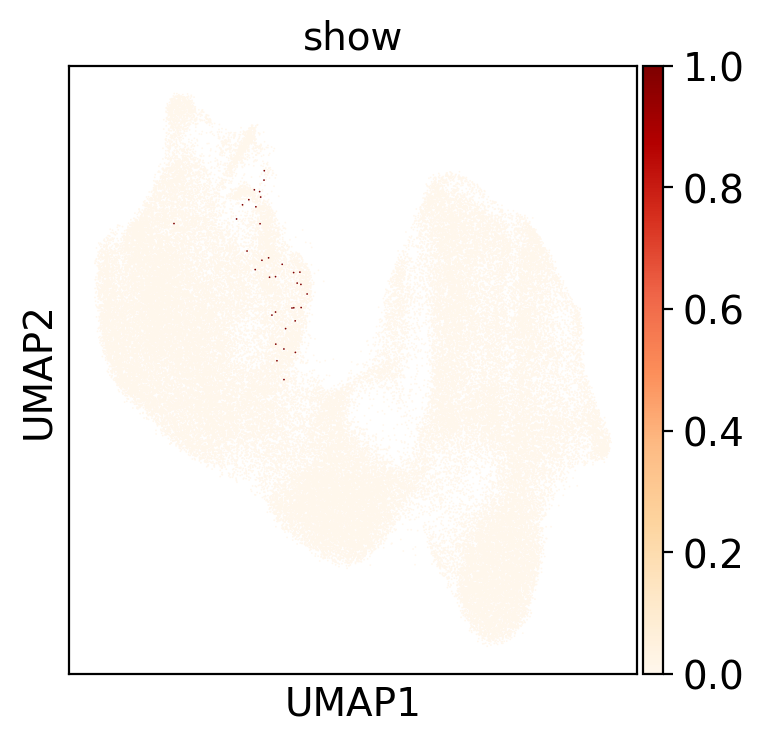

In [256]:
scjp.umap_show(bdata,bdata.obs['method']=='SS2')

In [258]:
C = bdata.uns['neighbors']['connectivities']
mask = np.where(bdata.obs.method=='SS2')[0]
rmask = np.where(bdata.obs.method!='SS2')[0]
c = C[mask][:,rmask]
indice = np.argmax(c.todense(),axis=1).A1

... storing 'name' as categorical
... storing 'fetus' as categorical
... storing 'leiden' as categorical


02_Output/HTA07.A05.v02.Fig3_sort_GNG4.pdf


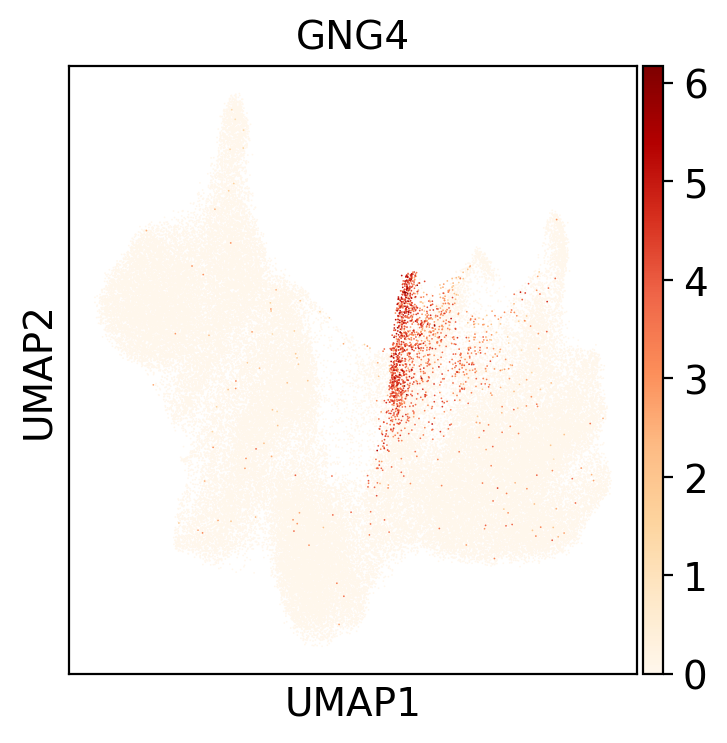

In [262]:
scjp.us(tdata,'GNG4',show=False)
scjp.jp_save_fig(version,'Fig3_sort_GNG4',fig_folder=fig_folder)

02_Output/HTA07.A05.v02.Fig3_sortdata_CD137.pdf


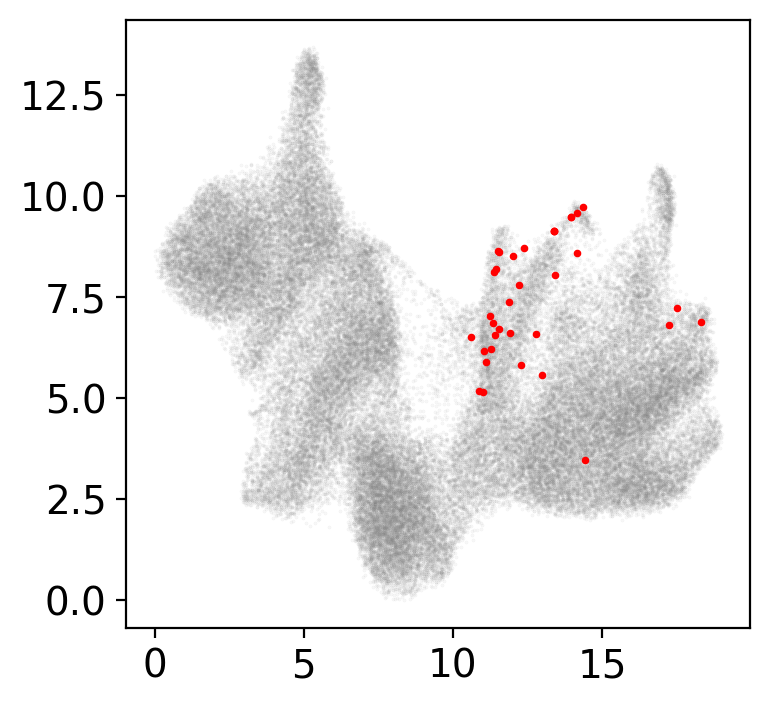

In [259]:
x1 = tdata.obsm['X_umap'][:,0]
y1 = tdata.obsm['X_umap'][:,1]

plt.scatter(x1,y1,rasterized=True,s=0.1,c='grey',alpha=0.1)
plt.scatter(x1[indice],y1[indice],s=3,c='r')

plt.grid(False)

scjp.jp_save_fig(version,'Fig3_sortdata_CD137',fig_folder=fig_folder)

In [260]:
scjp.write(bdata,version,'T_ss2_merge')

Only considering the two last: ['.v02', '.T_ss2_merge'].
HTA07_A05_v02_T_ss2_merge = 'HTA07.A05.v02.T_ss2_merge'


## fetal thymus gene expression

In [446]:
adata = fig1

c1 = adata.obs['donor'].str.startswith('F')
c2 = adata.obs['donor'] != 'F67'
c3 = adata.obs['method'] =='3GEX'
c4 = adata.obs['organ'] == 'TH'

fth = scjp.get_subset(adata,c1&c2&c3&c4)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:11.95)


In [447]:
ctlist = [

 'Treg(diff)',
 'Treg','T(agonist)',
 ' ',
    'CD8αα(I)',
'CD8αα(II)',
    ' ',
  'NKT',
  'Th17',
 ]

In [ ]:
m = markers.marker(fth,'Anno_level_5')

In [555]:
mkr_list = [
            'CD8A','CD8B',' ',
            'CD4','CD40LG',' ',
            'GNG8','PTGIR','PLN','FOXP3','CTLA4','PRDM1','MIR155HG',' ',
            
            'PDCD1','GNG4','CREB3L3','CD72','ZNF683','MME',
            ' ',
            'KLRB1','ZBTB16','NKG7','EOMES','IFNG','TBX21','RORC','CCR6',' ','KLF2',' ',
            'TNFRSF9','CD27','IKZF2','IKZF3']

02_Output/HTA08.v01.A06.Fig3_features_v2.pdf


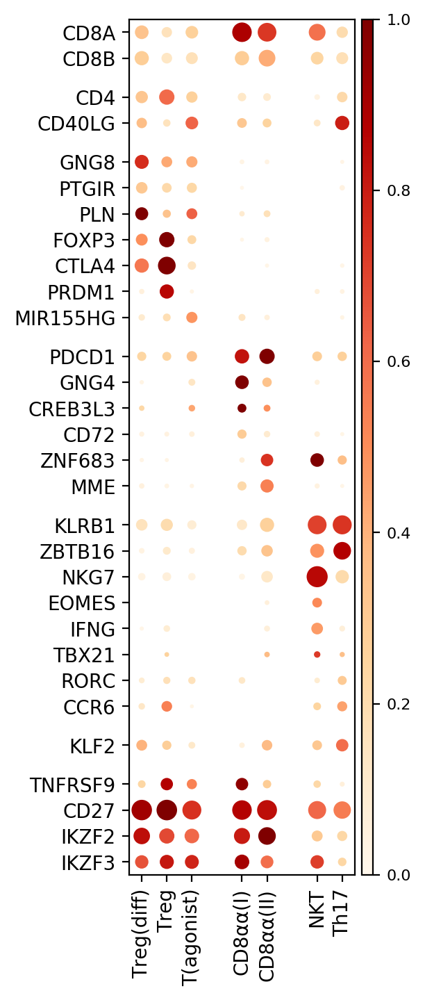

In [556]:
markers.draw_marker_blob_v2(fth,fth.uns['cdm_Anno_level_5'],mkr_list,ctlist = ctlist, show=False,cmap='OrRd')
scjp.jp_save_fig(version,'Fig3_features_v2',fig_folder=fig_folder)

In [587]:
ctlist = [
    
'Treg','Treg(diff)','T(agonist)',
 ' ','CD4+T','CD8+T',' ',
'CD8αα(I)','CD8αα(II)'
 ]

02_Output/HTA08.v01.A06.Fig3_features_Tagonist.pdf


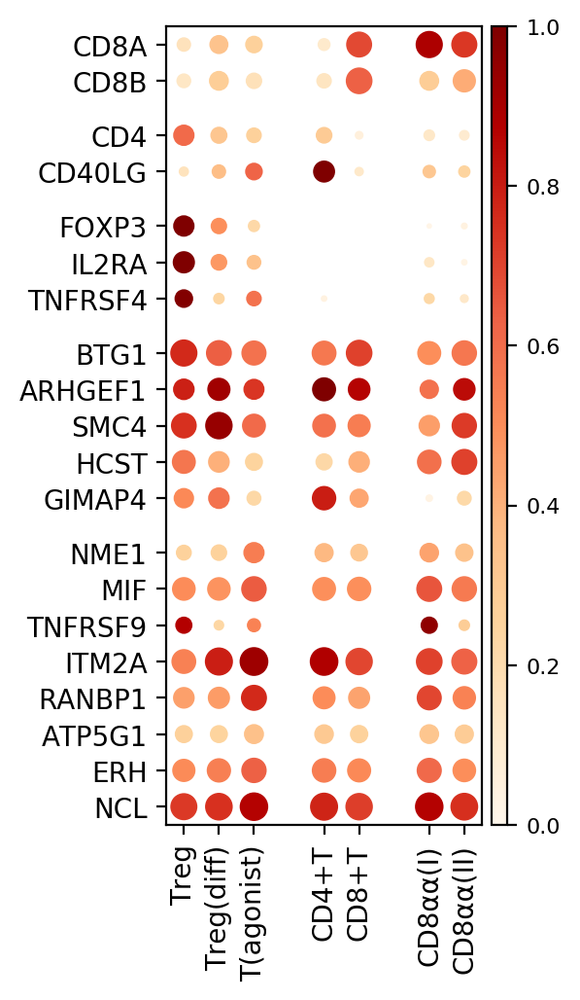

In [591]:
mkr_list = [
            'CD8A','CD8B',' ',
            'CD4','CD40LG',' ','FOXP3','IL2RA', 'TNFRSF4', ' ',
    'BTG1','ARHGEF1','SMC4','HCST','GIMAP4',
     ' ','NME1','MIF','TNFRSF9','ITM2A','RANBP1','ATP5G1','ERH','NCL',
]

markers.draw_marker_blob_v2(fth,fth.uns['cdm_Anno_level_5'],mkr_list,ctlist = ctlist, show=False,cmap='OrRd')
scjp.jp_save_fig(version,'Fig3_features_Tagonist',fig_folder=fig_folder)

02_Output/HTA08.v01.A06.Fig3_features_Tagonist_FOXP3IL2RA.pdf


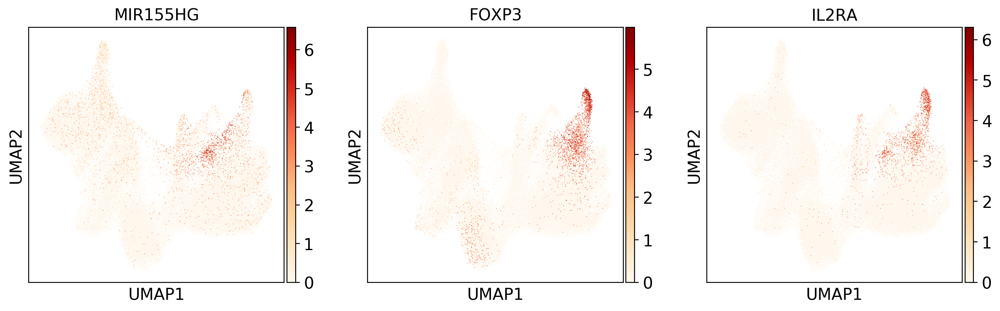

In [599]:
scjp.us(tdata,'MIR155HG,FOXP3,IL2RA',show=False)
scjp.jp_save_fig(version,'Fig3_features_Tagonist_FOXP3IL2RA',fig_folder=fig_folder)

02_Output/HTA08.v01.A06.Fig3_features_Tagonist_FOXP3IL2RA_fdg.pdf


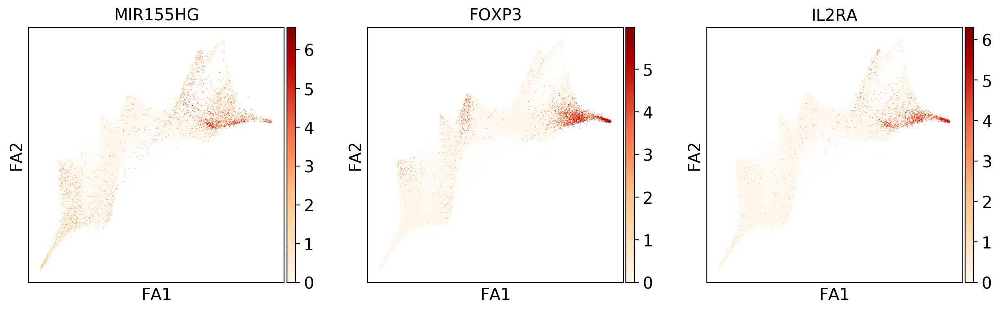

In [626]:
sc.pl.draw_graph(tdata,color='MIR155HG,FOXP3,IL2RA'.split(','),show=False)
scjp.jp_save_fig(version,'Fig3_features_Tagonist_FOXP3IL2RA_fdg',fig_folder=fig_folder)

In [633]:
tdata.uns['neighbors']['connectivities']

<76994x76994 sparse matrix of type '<class 'numpy.float64'>'
	with 9364487 stored elements in Compressed Sparse Row format>

02_Output/HTA08.v01.A06.FIG3_T_UMAP_treg.pdf


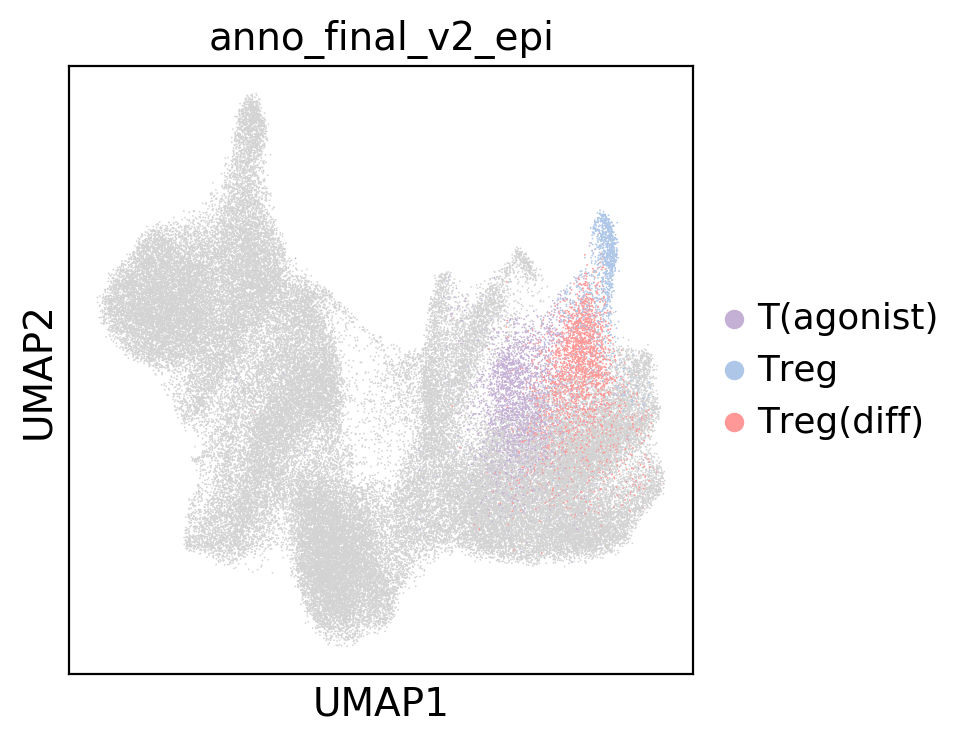

In [600]:
sc.pl.umap(tdata,color=fig3_anno_key,groups=['T(agonist)',
 'Treg',
 'Treg(diff)'
],show=False)
scjp.jp_save_fig(version,'FIG3_T_UMAP_treg',fig_folder=fig_folder)

02_Output/HTA08.v01.A06.FIG3_T_fdg_treg.pdf


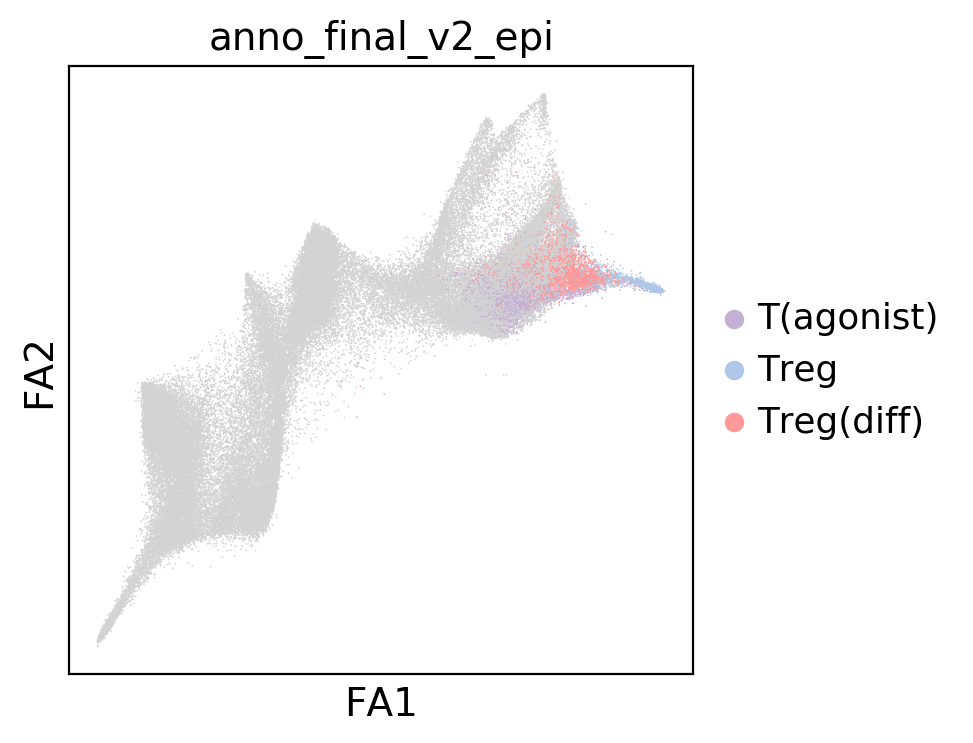

In [602]:
sc.pl.draw_graph(tdata,color=fig3_anno_key,groups=['T(agonist)',
 'Treg',
 'Treg(diff)'
],show=False)
scjp.jp_save_fig(version,'FIG3_T_fdg_treg',fig_folder=fig_folder)

## Run network analysis

## [Loading point]

In [22]:
# parameters

n_neighbor = 30
np.random.seed(0)

In [20]:
bdata = sc.read('HTA07.A05.v02.fig2_tdata')
idata = sc.read('HTA07.A05.v02.fig2_networt_imputed')
select = pkl.load(open(version+'select.pkl','rb'))

Only considering the two last: ['.v02', '.fig2_tdata'].


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Only considering the two last: ['.v02', '.fig2_networt_imputed'].


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [23]:
anno_key = fig3_anno_key
anno_uniq, anno_ratio = scjp.network.impute_anno(bdata,select,anno_key,n_neighbor=n_neighbor)

In [24]:
anndata = sc.AnnData(anno_ratio)
anndata.obs_names = anno_uniq

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


selecting hvgs...


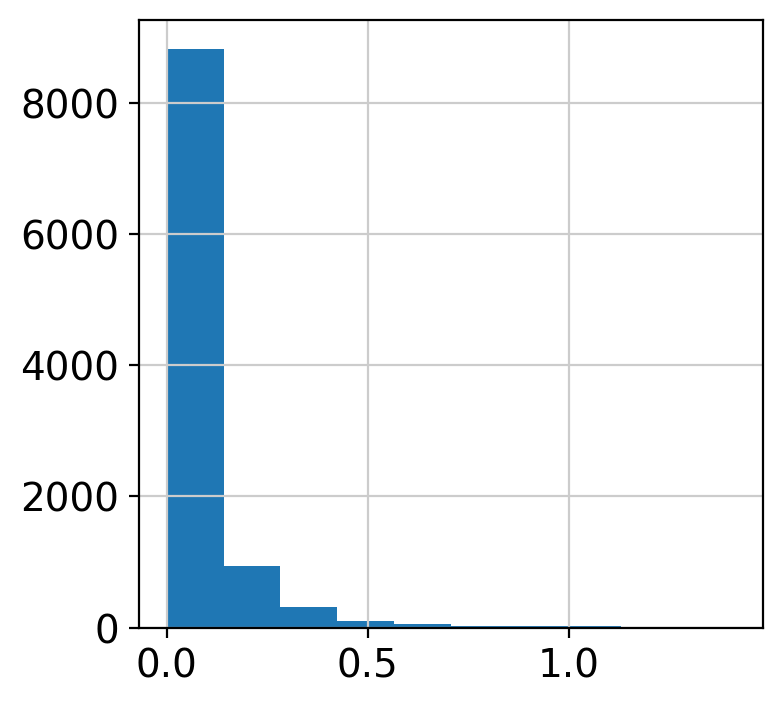

max: 1.4115651
mean: 0.062041305
min: 0.0
dispersions_norm: 1.7512404


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [25]:
tfdata,gdata,result = network.new_exp_matrix(bdata,idata,select,
                        tflist=scjp.tf_lists,max_cutoff=0.2,ratio_expressed=0.01,
                        min_disp=.75, n_min_exp_cell = 200,
                        example_gene='CREB3L3')

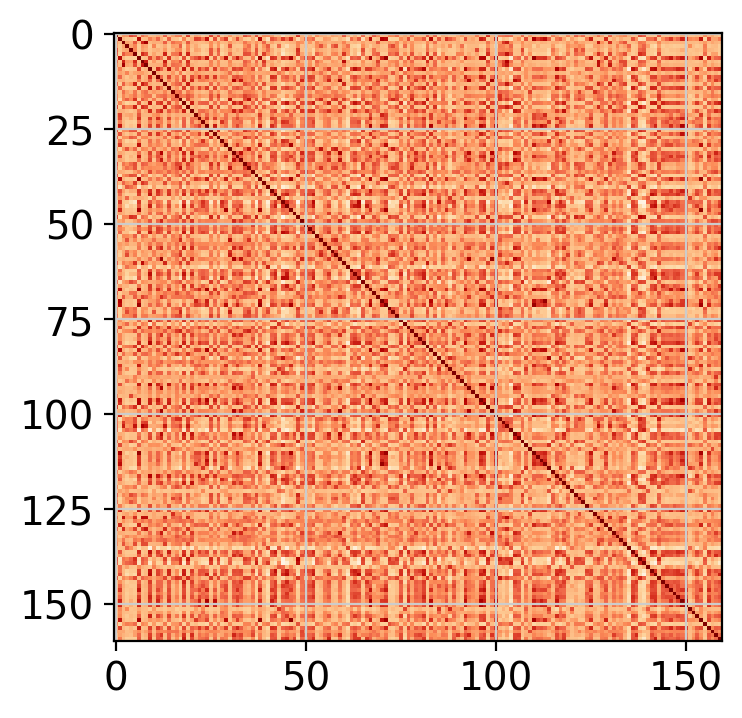

/home/ubuntu/.local/lib/python3.6/site-packages/scipy/sparse/compressed.py:287: SparseEfficiencyWarning:

Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.



In [26]:
# calculate connectivities based on correlation

C = scipy.sparse.csr_matrix(np.corrcoef(tfdata.X.todense()))
plt.imshow(C.todense())
plt.show()
C[C<0.3] = 0

tfdata.uns['neighbors'] = {}
tfdata.uns['neighbors']['connectivities'] = C
tfdata.uns['neighbors']['params'] = {'n_neighbors': 15, 'method': 'umap', 'metric': 'cosine'}

In [27]:
network.generate_gene_network(tfdata)

computing UMAP
         Falling back to preprocessing with `sc.pp.pca` and default params.
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:00.09)
    finished (0:00:02.73) --> added
    'X_umap', UMAP coordinates (adata.obsm)
drawing single-cell graph using layout "fa"
    finished (0:00:00.24) --> added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm)
drawing single-cell graph using layout "fr"
    finished (0:00:00.39) --> added
    'X_draw_graph_fr', graph_drawing coordinates (adata.obsm)
drawing single-cell graph using layout "kk"
    finished (0:00:00.73) --> added
    'X_draw_graph_kk', graph_drawing coordinates (adata.obsm)


02_Output/HTA07.A05.v02.Fig2I_network.pdf


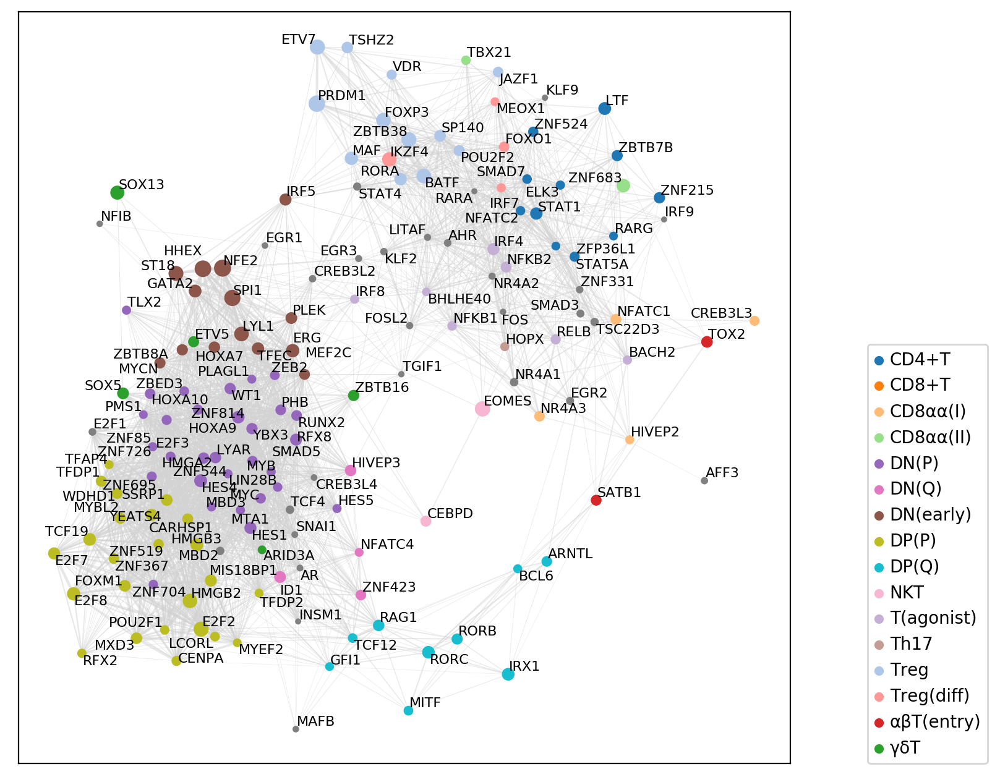

In [31]:
network.draw_graph(tfdata, anno_key, anno_uniq, anno_ratio,factor0=100.0, adjust=True,
           text_fontsize=8,z_score_cut=0.4,color_dict=fig3_cdict,
          axis='X_draw_graph_kk')
scjp.jp_save_fig(version,'Fig2I_network',fig_folder=fig_folder)

## Finding marker genes

creating lr model...


/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.



making lr prediction...
updating lr to adata...


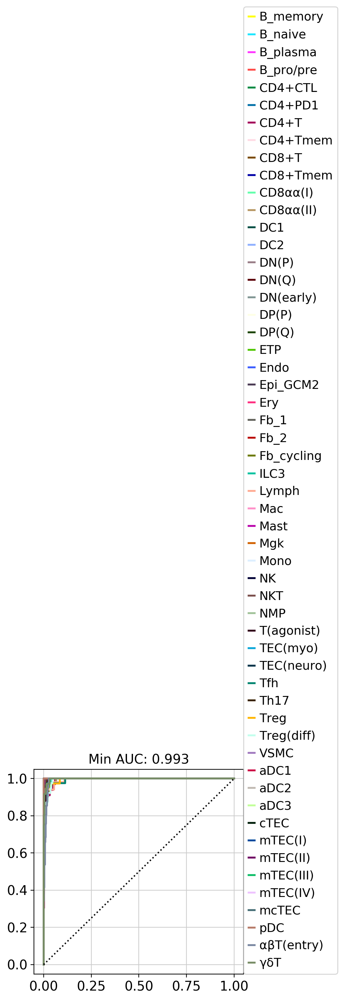

In [338]:
lr = model.transfer_annotation_jp(fig1,'Anno_level_5',fig1,'temp')

In [339]:
jl.dump(lr,version+'lr_model_fig1_Anno_level_5.pkl')

['HTA07.A05.v02.lr_model_fig1_Anno_level_5.pkl']

In [357]:
genelist = np.array(fig1.raw.var_names)
mks_genes = []

for i,cl in enumerate(lr.classes_):
    mks_genes.extend(genelist[np.argsort(-lr.coef_[i])][:5])

02_Output/HTA07.A05.v02.Fig_S02_supple_markers.pdf


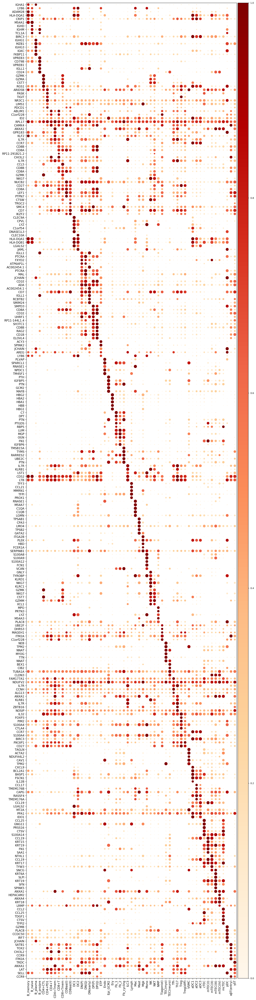

In [359]:
markers.draw_marker_blob_v2(fig1,fig1.uns['cdm_Anno_level_5'],
                         mks_genes,ctlist=list(lr.classes_),show=False)
scjp.jp_save_fig(version,'Fig_S02_supple_markers',fig_folder=fig_folder)

In [363]:
lr.coef_.shape

(55, 33694)

In [364]:
mkdf = pd.DataFrame(lr.coef_)
mkdf.columns = fig1.raw.var_names
mkdf.index = lr.classes_

In [366]:
mkdf = mkdf.T

In [650]:
glist = fig1.raw.var_names

In [654]:
mks = {}
for i, ct in enumerate(lr.classes_):
    mks[ct] = glist[np.argsort(-lr.coef_[i])][:20]

In [657]:
df = pd.DataFrame(mks)

In [658]:
df.to_csv(version+'Anno_level_5_mks_v2.csv')

In [647]:
mkdf.to_csv(version+'Anno_level_5_mks.csv')

In [412]:
ct = 'DN(Q)'
mkdf[ct][np.argsort(-mkdf[ct])][:30]

index
PTCRA            0.117046
MAL              0.098325
JCHAIN           0.097123
CD1E             0.070144
ADA              0.062465
UGT3A2           0.061096
LRRC28           0.060453
IL7R             0.059957
LIMS2            0.058617
RP11-404O13.5    0.058386
TRDC             0.057851
ATP6AP1L         0.057409
ID1              0.056669
SELL             0.056047
GALNT2           0.055846
AC011893.3       0.054963
ADGRG1           0.053533
TFDP2            0.052055
MSI2             0.051799
CD7              0.051683
HIVEP3           0.051102
LETM1            0.050921
NAPA             0.049390
MME              0.049015
UGP2             0.048726
FXYD2            0.048585
CTD-2376I20.1    0.047595
ARPP21           0.047594
CD1B             0.047520
DEFA6            0.047458
Name: DN(Q), dtype: float64

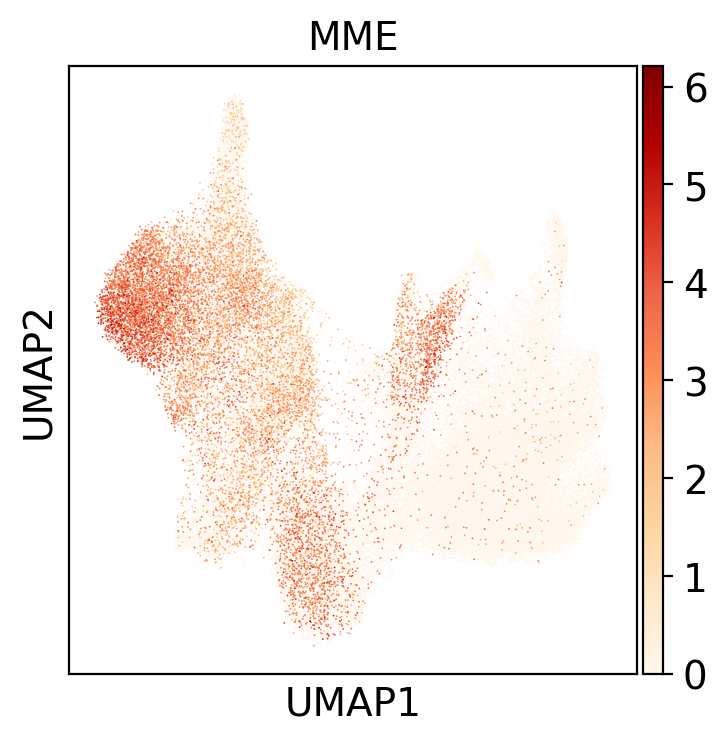

In [420]:
scjp.us(tdata,'MME')

## Fig1 meta table

In [432]:
meta_all = fig1.obs

In [435]:
set([x+y+z for x,y,z in zip(meta_all['donor'],meta_all['method'],meta_all['sort'])])

{'A163GEXTOT',
 'A165GEXTOT',
 'A435GEX45NM',
 'A435GEXTOT',
 'C345GEXTOT',
 'C403GEXTOT',
 'C413GEXTOT',
 'F213GEX45N',
 'F213GEX45P',
 'F223GEXTOT',
 'F233GEX45N',
 'F233GEX45P',
 'F293GEX45N',
 'F293GEX45P',
 'F295GEX45P',
 'F303GEX45N',
 'F303GEX45P',
 'F305GEX45P',
 'F383GEX45N',
 'F383GEX45P',
 'F385GEX45P',
 'F413GEX45N',
 'F413GEX45P',
 'F415GEX45N',
 'F415GEX45P',
 'F453GEX45N',
 'F453GEX45P',
 'F455GEX45N',
 'F455GEX45P',
 'F645GEXTOT',
 'F675GEXTOT',
 'F745GEXTOT',
 'F835GEXEPCAM',
 'P13GEXCD3N',
 'P13GEXCD3P',
 'P23GEXCD3N',
 'P23GEXCD3P',
 'P33GEXCD3N',
 'P33GEXCD3P',
 'T035GEXTOT',
 'T065GEXTOT',
 'T075GEXEPCAM',
 'T075GEXTOT'}

In [431]:
for s, dfs in fig1.obs.groupby(['Sample']):
    meta = dfs.iloc[0]
    print(s, meta['organ'], len(dfs))

A16_TH_TOT_1 TH 941
A16_TH_TOT_2 TH 1104
A16_TH_TOT_3 TH 951
A16_TH_TOT_4 TH 1137
A16_TH_TOT_5 TH 1793
A16_TH_TOT_5GEX_1 TH 728
A16_TH_TOT_5GEX_2 TH 1160
A16_TH_TOT_5GEX_3 TH 1413
A16_TH_TOT_5GEX_4 TH 1462
A16_TH_TOT_5GEX_5 TH 1557
A16_TH_TOT_5GEX_6 TH 1524
A16_TH_TOT_5GEX_7 TH 1689
A16_TH_TOT_5GEX_8 TH 1958
A16_TH_TOT_6 TH 1746
A16_TH_TOT_7 TH 1665
A16_TH_TOT_8 TH 1843
A43_TH_45NM_5GEX_1 TH 8663
A43_TH_45NM_5GEX_2 TH 8989
A43_TH_TOT_5GEX_1 TH 4652
A43_TH_TOT_5GEX_2 TH 500
C34_TH_TOT_5GEX TH 390
C40_TH_TOT_1 TH 6841
C40_TH_TOT_2 TH 7180
C41_TH_TOT_1 TH 5620
C41_TH_TOT_2 TH 5789
F21_TH_45N TH 4406
F21_TH_45P TH 4075
F22_TH_TOT TH 3137
F23_TH_45N TH 3097
F23_TH_45P TH 2677
F29_TH_45N TH 415
F29_TH_45P TH 5731
F29_TH_45P_5GEX TH 5254
F30_TH_45N TH 2920
F30_TH_45P TH 4615
F30_TH_45P_5GEX TH 5199
F38_TH_45N_1 TH 1595
F38_TH_45N_2 TH 1857
F38_TH_45P TH 2535
F38_TH_45P_5GEX TH 3047
F41_TH_45N TH 3179
F41_TH_45N_5GEX TH 2078
F41_TH_45P TH 3059
F41_TH_45P_5GEX TH 1285
F45_TH_45N TH 8368
F45_TH_